# TP-CBIR (Content Based Image Retrieval) - Indexation
# -----------------------------------------------------------------

## Réalisé par:
##                    - KANA NGUIMFACK Kévin
##                    - OUEDRAOGO Wend-Panga Jérémie

#### Il est question dans ce travail, d'implementer un système de recherche d'images par le contenu (CBIR), compte tenu des limites de systèmes de recherche par mots clés, très fastidieux pour une base énorme car annotation à la main, donc perte de temps, et performance influencée par les erreurs humaines. Alors nous utilisons cette approche automatisé (CBIR), permettant la recherche d'images, dans une base préalablement indexé,  à partir des descripteurs d'une image requête préalablement calculées, en utilisant une métrique de similarités. Nous exploitons ici, dans les sources multimédia images, les informations de couleur de l'espace RVB ou RGB (en anglais) et de forme. Le dataset utilisé, est COIL-100, de 100 classes, avec un total de 7200 images.

# Baseline
# ------------------------------

### 1- Chargement de tous les fichiers de notre dataset (100 classes, 72 images / classe)
### 2- Définition de fonctions des signatures (caractéristiques)
#####    - Descripteurs de couleur: Histogramme de couleur (RGB)
#####    - Descripteurs de forme: Calcul des	moments	et	des	caractéristiques	
### 3- Indexation de la base de données COIL-100
#####    - Sauvegarde des descripteurs sous format binaire pickle(.pkl)
### 4- Definition des métrique d'évaluation de similarité
#####    - métrique d'évaluation de l'histogramme de couleurs: la	méthode	du	Chi-2	(ou	Chi-square)	
#####    - métrique d'évaluation de l'histogramme de couleurs: la	méthode	distance euclidienne
#####    - métrique globale: la	somme pondéré des métriques ci-dessous 
######   Distance	=	ω1	∗	dist_couleur	+	ω2	∗	dist_forme		,  Avec	ω1+ω2	=1.(par	défaut	ω1=	ω2	=	0,5)	
### 5- Recherche d'images à partir d'une image requête 
#####   -Nous retournerons les 10 premiers resultas, selon un ordre croissante de similarité (la similarité est d'autant forte que la métrique est plus petite)
### 6- Evaluation sur 100 images requêtes ( 1 image / classes)

# Importation des libraries, pour notre travail

In [1]:
import cv2
import numpy as np
import pandas as pd
import glob
from math import copysign, log10
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import os
import math
from sklearn.decomposition import PCA
from sklearn.cluster import MiniBatchKMeans, KMeans, AgglomerativeClustering
from sklearn import metrics
from scipy.spatial.distance import cdist
import scipy.cluster.hierarchy as shc
from sklearn.metrics.pairwise import pairwise_distances_argmin
import time

# Chargement dataset COIL-100

### Récupération de chaque fichier image, en utilisant la librairies glob 

In [2]:
db_path='./coil-100/'

images_filenames  =  glob.glob( db_path +'*.png')
images_filenames

['./coil-100/obj20__105.png',
 './coil-100/obj90__325.png',
 './coil-100/obj93__85.png',
 './coil-100/obj55__195.png',
 './coil-100/obj11__280.png',
 './coil-100/obj81__340.png',
 './coil-100/obj30__330.png',
 './coil-100/obj86__80.png',
 './coil-100/obj83__60.png',
 './coil-100/obj89__20.png',
 './coil-100/obj72__320.png',
 './coil-100/obj31__10.png',
 './coil-100/obj85__70.png',
 './coil-100/obj94__220.png',
 './coil-100/obj25__280.png',
 './coil-100/obj16__60.png',
 './coil-100/obj56__40.png',
 './coil-100/obj3__160.png',
 './coil-100/obj36__130.png',
 './coil-100/obj79__125.png',
 './coil-100/obj77__275.png',
 './coil-100/obj56__235.png',
 './coil-100/obj56__245.png',
 './coil-100/obj72__215.png',
 './coil-100/obj91__50.png',
 './coil-100/obj72__0.png',
 './coil-100/obj93__120.png',
 './coil-100/obj86__135.png',
 './coil-100/obj9__320.png',
 './coil-100/obj36__280.png',
 './coil-100/obj50__265.png',
 './coil-100/obj79__115.png',
 './coil-100/obj95__190.png',
 './coil-100/obj58__135

In [3]:
print("COIL-100, nombre d'images: {}".format(len(images_filenames)))

COIL-100, nombre d'images: 7200


# Définition de fonctions des signatures (caractéristiques)

### __Step__ 0: Reduction de la quantification
##### Les valeurs de l'images étant comprises entre 0  et 255, il s'agit de leur ramené entre 0 et 32. A cet effet nous avons eu à choisir 32 valeurs.

#### La fonction reduceQuantification, prend en paramètres, une images couleur de quantification 0-255 et la nouvelle valeur maximale de quantification prédéfinie (quantification_value, ici fixé à 32), et retourne une image couleur de quantification 0-32

In [4]:
# reduction of number value
quantification_value = 32

def reduceQuantification(nb_values = quantification_value , image = None):
    # Diviser l'image en ses differents channel, rouge, vert, et blue.
    R, G, B= cv2.split(image)
    
    for i in range(B.shape[0]): # B.shape[0]: hauteur de l'image
        for j in range(B.shape[1]): # B.shape[1]: largeur de l'image
            B[i][j] = round(B[i][j] * nb_values / 255)
            G[i][j] = round(G[i][j] * nb_values / 255)
            R[i][j] = round(R[i][j] * nb_values / 255)
    
    # Fusionner les differentes channel pour obtenir l'image couleur initiale
    image = cv2.merge((R, G, B))        
    return image

### __Step__ 1: Fonction d'extraction d' extraction des caractéristiques de couleurs (histogramme couleur)
#### Pour une image donnée, nous construisons ici deux types d'histogramme,un histogramme de taille 3*32 (96) et un autre  histogramme 3D de dimensions 32x32x32 (32768) par intersection de couleurs, pour cela la fonction calHist de la librairie opencv est utilisée, puis nous normalisons les histogrammes et aplatissons l'histogramme dans le cas  3D ainsi  afin d'avoir le vecteur caractéristique couleur de l'image de taille 32768 . 

#### Les fonction Histo3DFeatureColor et Histo3DFeatureColor, prennent en paramètres, une image couleur et les bacs d'histogramme prédéfinis, et retourne un vecteur de caractéristique d' histogramme couleur.

#### Mais compte de la taille élévée du vecteur de caractéristique obtenu de l'histogramme 3D, nous utilisons ici l'histogramme de taille de taille 96, étant la concaténation des histogrammes 1D de taille 32 sur chaque channels, afin de gagner en temps de calcul.

In [5]:
_bins = (32,32,32)

def Histo3DFeatureColor(image = None, bins= _bins):
    hist = cv2.calcHist([image], [0, 1, 2], None, bins,[0, 32, 0, 32, 0, 32])
    # Normalisation de l'histogramme, pour reduire l'influence du nombre de pixels pour chaque bins.
    features_vector = cv2.normalize(hist, hist).flatten()
    return np.asarray(features_vector)

def HistoFeatureColor(image = None, bins= 32):
    
    hist_b = cv2.calcHist([image], [2], None, [bins],[0, 32])
    hist_g = cv2.calcHist([image], [1], None, [bins],[0, 32])
    hist_r = cv2.calcHist([image], [0], None, [bins],[0, 32])
    # Normalisation de l'histogramme, pour reduire l'influence du nombre de pixels pour chaque bins.
    hist_b = cv2.normalize(hist_b,hist_b)
    hist_g = cv2.normalize(hist_g,hist_g)
    hist_r = cv2.normalize(hist_r,hist_r)
    
    # concatenation
    histoCat = np.concatenate((hist_b,hist_g), axis=None)
    histoCat = np.concatenate((histoCat, hist_r), axis=None)
    
    return np.asarray(histoCat)

### __Step__ 2: Fonction d'extraction des caractéristiques de forme (Moments de Hu)
#### L'image couleur cible sera préalablement convertir en niveau de gris. Puis calculer les moments et les caractéristiques de l'image donnée, le moment de Hu permet d'estimer la forme de l'object dans une 'image. Les caractéristiques de Hu définis, au nombre de 7, seront déduits des moments précalculés.

#### Etapes:
##### - convertion image en niveau de gray.
##### - Utiliser une approche de segmentation par seuillage  (resultat image noir-blanc, image binaire).
##### - Calcul des moments associés à l'image ( la moyenne pondérée des intensités de pixels de l'image).
##### - Déterminer les caractéristiques du Moment de Hu (au nombre de 7), de l'object.
#### Les invariants de moment Hu sont calculés en utilisant des moments centraux invariants aux transformations d'image. Les 6 premiers moments se sont avérés être invariants à la translation, à l'échelle, à la rotation et à la réflexion. Et le signe du 7ème moment change pour la réflexion de l'image.

#### La fonction ObjectFeatureShape, prend en paramètre une image couleur, et retourne les caractéristiques de Hu associés à l'image.

In [6]:
def ObjectFeatureShape(image = None):
    # convertir l'image en niveau de gris
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    # seuillage adaptative de l'image
    _, gray_th_otsu = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    # calcul des moments centraux de l'images
    moments = cv2.moments(gray_th_otsu)
    # calcul des moments de Hu (7) en utilisants les moments centraux
    Hu_moments = cv2.HuMoments(moments)
    """
        Notons que les moments de Hu, ainsi obtenus, sont parfois très variables à l'echelle.
        Afin de palier à ce problème, nous les ramenons sur la même echelle, en effectuant 
        une transformation logarithmique decimale, tel que H(i) = -sign(hi)log10(|hi|)
    """
    for i in range(0,7):
        Hu_moments[i] = -1 * copysign(1.0, Hu_moments[i]) * log10(abs(Hu_moments[i]))
        
    return np.asarray(Hu_moments.flatten())

# Indexation de la base de données COIL-100

# -----------------------------------------------------------------
### Calcul des différentes signatures, sur notre dataset COIL-100

#### La fonction DatasetIndexing, prend en paramètres, l'ensemble des fichiers de notre dataset. 
#### Pour chaque fichier image, nous procédons comme suite:
##### - Lecture du fichier image
##### - Extraction des caractéristiques de couleurs et de forme
##### - Mise à jour de la structure de données, data prédéfinir
#### En fin sauvegarde du fichier data au format binaire pickle(.pkl).

In [7]:
def DatasetIndexing(images_files = images_filenames):
    """
        Definition de notre structure de données pour la sauvegarde des signatures 
        (histogramme de couleurs + descripteurs de Hu) et des noms d'images associés
    """
    # si le fichier d'indexation du dataset n'est pas crée, alors la section est éxécutée
    if not (os.path.isfile("IndexingDataset.pkl")):
        data = pd.DataFrame(columns=("name_file","features_color", "features_shape"))
        for filename in images_files:
            # lire le fichier image
            _img = cv2.imread(filename)
            _img = cv2.cvtColor(_img, cv2.COLOR_BGR2RGB)
            img = reduceQuantification(nb_values = quantification_value , image = _img)
            # extraction des caractéristiques de couleurs de l'image
            features_color = HistoFeatureColor(image = img, bins = 32)
            # extraction des caractéristiques de forme de l'image
            features_shape = ObjectFeatureShape(image = img)
            # pour contenir les informations courantes, avant insertion dans data
            dic = dict()
            fn = filename.split('/') # séparation du chemin relatif par le séparateur '/'

            dic["name_file"] = fn[2] #extraction du nom de l'image 
            dic["features_color"] = features_color
            dic["features_shape"] = features_shape

            # mise à jour de variable de stockage data 
            data = data.append(dic, ignore_index=True)

        # Sauvegarde du dataset après indexation
        data.to_pickle("IndexingDataset.pkl")

In [8]:
DatasetIndexing(images_files = images_filenames)

### Prévisualisation de la sauvegarde

In [9]:
indexed_db = pd.read_pickle('IndexingDataset.pkl')

In [10]:
# affichage des 10 premiers lignes
indexed_db.head(10)

,name_file,features_color,features_shape
0,obj20__105.png,"[0.0031384968, 0.020086378, 0.09490814, 0.9402...","[3.001966129607334, 6.579216781115412, 10.2606..."
1,obj90__325.png,"[0.0021612635, 0.006577758, 0.054877296, 0.986...","[2.804446450463385, 5.865106807089411, 9.22343..."
2,obj93__85.png,"[0.00038604913, 0.0039570034, 0.19842926, 0.97...","[2.9941863659821424, 6.323365186405546, 9.7935..."
3,obj55__195.png,"[0.0, 0.010646585, 0.048022896, 0.74186313, 0....","[3.15523197868933, 7.743223982295529, 10.77530..."
4,obj11__280.png,"[0.0, 0.0018382324, 0.16053896, 0.9341897, 0.1...","[3.144574987206589, 7.00370220491629, 10.67299..."
5,obj81__340.png,"[0.0, 0.008925141, 0.29628763, 0.8914322, 0.21...","[2.694029322086657, 8.746101882102247, 8.51452..."
6,obj30__330.png,"[0.00022796108, 0.004673202, 0.121617235, 0.97...","[3.0454146567097222, 6.769891867439611, 10.007..."
7,obj86__80.png,"[0.0003896021, 0.0055842963, 0.07960869, 0.943...","[3.087784648081366, 6.8561580029635305, 10.805..."
8,obj83__60.png,"[0.024732675, 0.2647493, 0.4021801, 0.843835, ...","[3.174572184563596, 7.620239643099023, 10.4049..."
9,obj89__20.png,"[0.0, 0.00015653898, 0.015027743, 0.8928984, 0...","[3.009894249703678, 6.648599800363823, 9.85820..."


In [11]:
# afficher nom première image
indexed_db["name_file"][0]

'obj20__105.png'

In [12]:
# afficher features_color première image
indexed_db["features_color"][0]

array([3.13849677e-03, 2.00863779e-02, 9.49081406e-02, 9.40293610e-01,
       1.93959102e-01, 1.33825496e-01, 9.89254192e-02, 8.91333073e-02,
       1.04323633e-01, 7.70814791e-02, 6.05102144e-02, 7.48217627e-02,
       6.74149096e-02, 4.08004560e-02, 2.46058144e-02, 1.46881649e-02,
       5.02159446e-03, 2.88741686e-03, 2.13417783e-03, 1.88309804e-03,
       1.75755820e-03, 1.25539862e-03, 1.88309804e-03, 1.12985878e-03,
       3.76619602e-04, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 9.54878796e-03, 9.52001095e-01,
       1.14716262e-01, 3.97648178e-02, 6.01704456e-02, 1.00066066e-01,
       1.17201567e-01, 8.84243920e-02, 6.68415204e-02, 6.72339350e-02,
       6.97192326e-02, 8.88168141e-02, 7.76983574e-02, 7.10272864e-02,
       7.73059428e-02, 5.28453477e-02, 3.38785760e-02, 2.72075068e-02,
       1.19032841e-02, 5.88623947e-03, 1.96207967e-03, 2.22369051e-03,
      

In [13]:
# afficher nom features_shape première image
indexed_db["features_shape"][0]

array([  3.00196613,   6.57921678,  10.26060017,  10.48310894,
        20.90758846,  13.77333282, -21.18852605])

In [14]:
# taille caractéristique couleurs
indexed_db["features_color"][0].shape

(96,)

In [15]:
# taille caractéristiques forme
indexed_db["features_shape"][0].shape

(7,)

In [16]:
indexed_db.shape

(7200, 3)

# Definition des métrique d'évaluation de similarité

### __Step__ 1: Métrique d'évaluation de l'histogramme de couleurs: la méthode du Chi-2 (ou Chi-square)
#### Nous utilisons ici la fonction Chi-2, qui tire son nom de la statistique de test du chi carré de Pearson, utilisée pour comparer les distributions de probabilité discrètes.

#### Notre fonction, chi2Distance prend en paramètres, une descripteur couleur de notre base indexée, et le descripteur couleur de l'image requête, et un dernier paramètre eps permettant d'éviter les division par zéro. 
#### Elle retourne la distance descrivant la similarité entre les deux histogrammes, plus elle est grande et moins ils sont similaires.

In [17]:
def Chi2Distance(features_color_db = None, features_color_query = None, eps = 1e-10):
    # calcul de la distance chi-squared
    dist_chi2 = 0.5 * np.sum([((a - b) ** 2) / (a + b + eps) 
                              for (a, b) in zip(features_color_db, features_color_query)])
    
    return dist_chi2

### __Step__ 2: Métrique d'évaluation de forme (Moments de Hu): la méthode distance euclidienne

#### Nous calculons la distance euclidienne entre  deux descripteurs de Hu, respectivement  un descripteur de reférence dans notre base indexée et le descripteur de l'image requête.
#### La fonction, DistanceEuclidienne prend ses 2 paramètres, et retourne la distance descrivant la similarité entre les deux moments de Hu, plus elle est grande et moins ils sont similaires.

In [18]:
def DistanceEuclidienne(features_shape_db = None, features_shape_query = None):
    # calcul de la distance euclidiene
    dist = np.sum([((a - b) ** 2) for (a, b) in zip(features_shape_db, features_shape_query)])
    dist = np.sqrt(dist)
    
    return dist

### __Step__ 3: Métrique globale: la somme pondéré des métriques ci-dessous
#### Distance = ω1 ∗ dist_couleur + ω2 ∗ dist_forme , Avec ω1+ω2 =1.(par défaut ω1= ω2 = 0,5)
#### La fonction Distance, prend en paramètres les métriques de signature de couleur et de forme, de l'image requête par rapport aux signatures couleur et forme d'une image donnée de la base modèle. Et elle retorne la distance pondérée calculée.

In [19]:
# Initialisation des poids
w1 = 0.50
w2 = 0.50

def Distance(dist_color = None, dist_shape = None):
    # Calcul de la métrique pondérée, à par des métriques de signature de couleur et de forme
    if dist_color > dist_shape:
        w1 = 0.20
        w2 = 0.80
    elif dist_color < dist_shape:
        w1 = 0.80
        w2 = 0.20
    else:
        w1 = 0.50
        w2 = 0.50
    distance = w1 * dist_color + w2 * dist_shape
    
    return distance

### __Step__ 4: Definition  fonctions utiles pour evaluation sur 100 images (1 image/classe)

In [20]:
test_path = './test/'

"""
   Fonction pour recuperer l'id de l'image à partir de son nom
"""
def getId(name_file = None):
    n_file = name_file.split('__')
    n_id = n_file[0].split('j')
    id = int(n_id[1])
    return id

"""
   Fonction pour mettre à jour la matrice confusion 100X100, de 0-99
"""
def UpdateConfMatrix(cf=None, id_test = None, resultats = None ):
    for res in resultats:
        # recuperer l'id du nom de fichier resultat
        id_res = getId(res)
        # incrementer la case correspondant de 1 pour le resultat prédire, à partir de id_test
        cf[id_test-1][id_res-1] = cf[id_test-1][id_res-1] + 1
    
    return cf

"""
    Dessiner la matrice de confusion
"""
def draw(cf = None):
    cf_matrix = cf
    plt.figure(figsize=(8, 8))
    plt.imshow(cf_matrix, interpolation='nearest', cmap='Blues')
    plt.title('confusion matrix')
    plt.colorbar()
    plt.show()
    

"""
    Performance d'évaluation
"""
def get_accuracy(cf = None):
    accuracy = np.trace(cf) / float(np.sum(cf))
    print("Accuracy d'évaluation:  {}%\nErreur d'évaluation: {}%".format(accuracy * 100, (1-accuracy) * 100))


"""
    Afficher resultats pou une image de test externe 
"""
def AfficherResultats(resultats = None, cols = 5, line = 3):
    nb_columns = cols
    nb_line = line
    fig, ax = plt.subplots(nb_line, nb_columns, sharex=True, sharey=True, figsize=(10,10))
    k = 0
    for i in range(nb_line):
        for j in range(nb_columns):
            img = cv2.imread(db_path + resultats[j + k])
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            ax[i,j].imshow(img)
            ax[i,j].set_title(resultats[j + k])
        k = k + nb_columns

    plt.show()

#### La fonction prepareQuery prend en paramètre le chemin de l'image requête:
##### - Lecture image requête, extraction des features et redimensionement, et fusion des caractéristique

In [21]:
def prepareQuery(path_image_query = None):
    # lire image requête
    img_query = cv2.imread(path_image_query)
    # convertir dans l' espace RGB
    img_query = cv2.cvtColor(img_query, cv2.COLOR_BGR2RGB)
    # reduction de la quantification
    img_query = reduceQuantification(nb_values = quantification_value , image = img_query)
    # Extraction caractéristique couleur et forme, de l'image requête
    query_features_color = HistoFeatureColor(image=img_query, bins=32)
    query_features_shape = ObjectFeatureShape(image=img_query)
    # draw histogramme image query
    displayHisto(img_origine = img_query, Histo = query_features_color)
    # supprimer l'image requête de la mémoire
    del img_query
    
    list_color = list()
    list_shape = list()
    # ajout features dans les listes respectives
    list_color.append(query_features_color)
    list_shape.append(query_features_shape)
    # convertir à un tableau numpy
    list_color = np.asarray(list_color)
    list_shape = np.asarray(list_shape)
    
    # reduction dimension
    query_features_color_pca = pca_color.transform(list_color)
    query_features_shape_pca = pca_shape.transform(list_shape)
    
    # name query image
    nquery = path_image_query.split('/')
    name_file = [ nquery[-1] ]
    name_file = np.asarray(name_file)
    
    # fusion des features,(1, 54)
    data = np.concatenate((query_features_color_pca, query_features_shape_pca), axis=1)
    data = np.concatenate((name_file.reshape(1,1), data), axis=1)
    # creation dataframe query
    query = pd.DataFrame(data=data, columns=['X_' + str(i) for i in range(data.shape[1])])
    
    return query



"""
    Fonction d'affichage histogramme de l'image requête
""" 
def displayHisto(img_origine = None, Histo = None):
    plt.subplot(221), plt.imshow(img_origine)
    plt.subplot(222), plt.plot(Histo[:32], color='b'), plt.plot(Histo[32:64], color='g'),plt.plot(Histo[64:96], color='r')
    plt.xlim([0,32])

    plt.show()

# Structuration d'indexes de notre base de descripteurs

### Nous utilisons trois méthodes:
#### - La méthode d'indexation basée sur les arbres (KD-Tree)
#### - La méthode de clustering (K-means)
#### - La méthode de hachage(LSH)

## __Step__ 1 : Indexation basée sur KD-Tree

In [22]:
! pip install binarytree

### concatenation features color & forme pour chaque image

In [23]:
indexed_db.columns

Index(['name_file', 'features_color', 'features_shape'], dtype='object')

In [24]:
# extraction des features de la base indexés
db_features_color = np.asarray(indexed_db['features_color'].values.tolist())
db_features_shape = np.asarray(indexed_db['features_shape'].values.tolist())

In [25]:
print(db_features_color.shape, db_features_shape.shape)

(7200, 96) (7200, 7)


## PCA: Reduction des dimensions  des features couleurs et formes, elle nous permet ainsi de reduire considérablement la compléxité des calculs

In [26]:
# choix du nombre de composantes à calculer
n_comp_color = db_features_color.shape[1]
n_comp_shape = db_features_shape.shape[1]
print(n_comp_color,';', n_comp_shape)

96 ; 7


In [27]:
# Calcul des composantes principales features couleurs
pca_color = PCA(n_components=n_comp_color)
pca_color.fit(db_features_color)

PCA(copy=True, iterated_power='auto', n_components=96, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

In [28]:
# Calcul des composantes principales features couleurs
pca_shape = PCA(n_components=n_comp_shape)
pca_shape.fit(db_features_shape)

PCA(copy=True, iterated_power='auto', n_components=7, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

### Recherche du nombre de composantes en conservant au moins 99% d’informations: pour features couleurs et formes.

Text(0.5, 1.0, 'Recherche du nombre de composantes features couleurs')

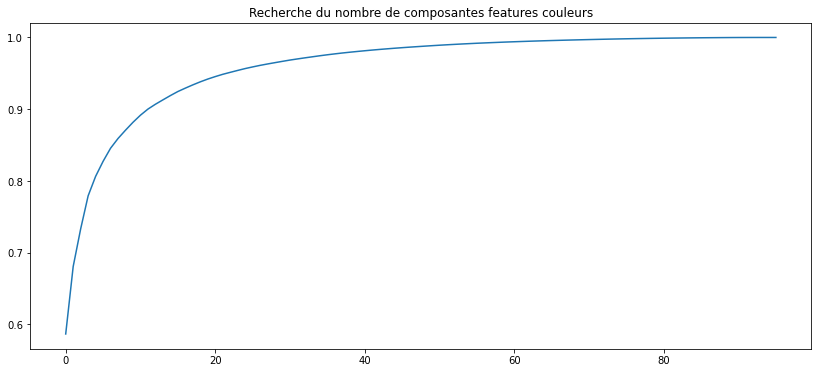

In [29]:
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(14, 6))
plt.plot(np.cumsum(pca_color.explained_variance_ratio_))
plt.title("Recherche du nombre de composantes features couleurs")

In [30]:
print("Réduction dimensions features couleurs (96) à: {} dimensions, en conservant 99% d'informations".format(np.argmax(np.cumsum(pca_color.explained_variance_ratio_) >= 0.99)))

Réduction dimensions features couleurs (96) à: 52 dimensions, en conservant 99% d'informations


Text(0.5, 1.0, 'Recherche du nombre de composantes features formes')

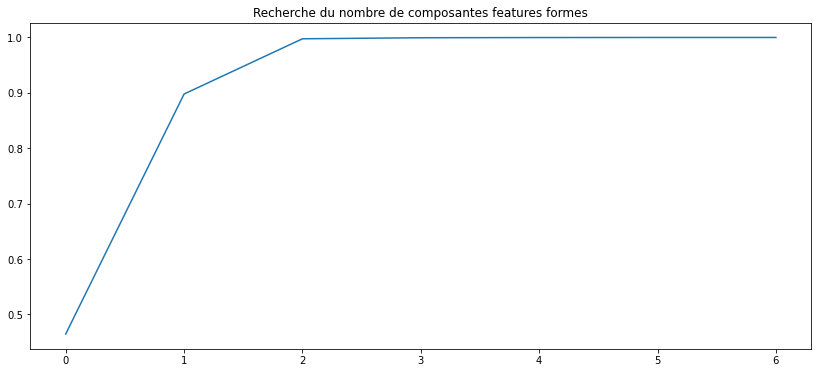

In [31]:
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(14, 6))
plt.plot(np.cumsum(pca_shape.explained_variance_ratio_))
plt.title("Recherche du nombre de composantes features formes")

In [32]:
print("Réduction dimensions features formes (7) à: {} dimensions, en conservant 99% d'informations".format(np.argmax(np.cumsum(pca_shape.explained_variance_ratio_) >= 0.99)))

Réduction dimensions features formes (7) à: 2 dimensions, en conservant 99% d'informations


In [33]:
# Nombre composantes à calculer
n_comp_color = 52
n_comp_shape = 2
pca_color = PCA(n_components=n_comp_color)
pca_shape = PCA(n_components=n_comp_shape)

In [34]:
pca_color.fit(db_features_color)
pca_shape.fit(db_features_shape)

PCA(copy=True, iterated_power='auto', n_components=2, random_state=None,
  svd_solver='auto', tol=0.0, whiten=False)

### Features couleurs et forme, dimensions reduites

In [35]:
db_features_color_pca = pca_color.transform(db_features_color)
db_features_shape_pca = pca_shape.transform(db_features_shape)

In [36]:
print(db_features_color_pca.shape, db_features_shape_pca.shape)

(7200, 52) (7200, 2)


In [37]:
print(type(db_features_color_pca), type(db_features_shape_pca))

<class 'numpy.ndarray'> <class 'numpy.ndarray'>


In [38]:
print(db_features_color_pca[0].shape, db_features_shape_pca[0].shape)

(52,) (2,)


In [39]:
name_files = np.asarray(indexed_db['name_file'].values.tolist())

In [40]:
name_files = name_files.reshape(7200,1)

In [41]:
name_files.shape

(7200, 1)

In [42]:
name_files

array([['obj20__105.png'],
       ['obj90__325.png'],
       ['obj93__85.png'],
       ...,
       ['obj43__165.png'],
       ['obj37__290.png'],
       ['obj82__180.png']], dtype='<U15')

In [43]:
# fusion des deux features (7200), pour en obtenir un tableau de 7200 élements de taille 52 + 2 = 54
data = np.concatenate((db_features_color_pca, db_features_shape_pca), axis=1)

In [44]:
data.shape

(7200, 54)

In [45]:
# ajout des noms fichiers relatifs à chaque feature
data = np.concatenate((name_files, data), axis=1)

In [46]:
data.shape

(7200, 55)

In [47]:
# taille de chaque element dans data 
data[0].shape

(55,)

In [48]:
data[0][:53] # feature couleur 1er element (52 dimensions)

array(['obj20__105.png', '-0.24551032483577728', '0.04424871876835823',
       '0.0652414932847023', '-0.06900810450315475',
       '-0.04607217013835907', '-0.040863193571567535',
       '-0.06827889382839203', '0.05500771850347519',
       '-0.02508840337395668', '0.1076759546995163',
       '0.05555517226457596', '-0.023457251489162445',
       '-0.04648726060986519', '-0.020364949479699135',
       '-0.012588610872626305', '-0.005905617494136095',
       '-0.007350872736424208', '-0.025173496454954147',
       '0.020767100155353546', '0.010019870474934578',
       '0.01136187557131052', '0.04898988455533981',
       '0.004856897052377462', '-0.025734273716807365',
       '-0.000602130254264921', '0.01744120568037033',
       '-0.010828915052115917', '0.014635092578828335',
       '-0.01257891021668911', '0.010284613817930222',
       '-0.015423286706209183', '-0.006526474840939045',
       '0.018820786848664284', '-0.005697651766240597',
       '0.006610543932765722', '0.0025194189

In [49]:
data[0][53:] # feature forme 1er element

array(['-20.760095210974445', '-10.91365236183969'], dtype='<U32')

### Creation dataframe de 55 dimensions avec 7200 elements
#### La structure créer sera exploiter dans nos méthodes de structuration

In [50]:
db_df = pd.DataFrame(data=data, columns=['X_' + str(i) for i in range(data.shape[1])])

In [51]:
# attributs (54 colonnes)
db_df.columns

Index(['X_0', 'X_1', 'X_2', 'X_3', 'X_4', 'X_5', 'X_6', 'X_7', 'X_8', 'X_9',
       'X_10', 'X_11', 'X_12', 'X_13', 'X_14', 'X_15', 'X_16', 'X_17', 'X_18',
       'X_19', 'X_20', 'X_21', 'X_22', 'X_23', 'X_24', 'X_25', 'X_26', 'X_27',
       'X_28', 'X_29', 'X_30', 'X_31', 'X_32', 'X_33', 'X_34', 'X_35', 'X_36',
       'X_37', 'X_38', 'X_39', 'X_40', 'X_41', 'X_42', 'X_43', 'X_44', 'X_45',
       'X_46', 'X_47', 'X_48', 'X_49', 'X_50', 'X_51', 'X_52', 'X_53', 'X_54'],
      dtype='object')

In [52]:
db_df.head()

,X_0,X_1,X_2,X_3,X_4,X_5,X_6,X_7,X_8,X_9,...,X_45,X_46,X_47,X_48,X_49,X_50,X_51,X_52,X_53,X_54
0,obj20__105.png,-0.24551032483577728,0.04424871876835823,0.0652414932847023,-0.06900810450315475,-0.04607217013835907,-0.040863193571567535,-0.06827889382839203,0.05500771850347519,-0.02508840337395668,...,-0.008001635782420635,0.007296987809240818,-0.001571016851812601,-4.752752374770353e-06,0.0022558525670319796,0.0032349538523703814,-0.0005534352385438979,0.008305247873067856,-20.760095210974445,-10.91365236183969
1,obj90__325.png,-0.37485215067863464,-0.16084247827529907,-0.03493546321988106,0.008492322638630867,-0.03858628123998642,0.07130929082632065,-0.05581536144018173,0.040403109043836594,-0.028717001900076866,...,0.0057045528665184975,-0.00021566481154877692,0.007578677032142878,0.006679983343929052,0.011851227842271328,-0.0020544370636343956,0.008653894998133183,-0.003010792890563607,-18.63289334790968,-8.335880238525997
2,obj93__85.png,-0.35484644770622253,-0.07213401049375534,0.005778567865490913,0.04917726293206215,-0.10743241757154465,0.0810004472732544,-0.1044389083981514,-0.006601844914257526,0.0008943231077864766,...,-0.003458762774243951,-0.02188669890165329,-0.012297947891056538,-0.009394362568855286,-0.01205709669739008,-0.0044657643884420395,-0.010425283573567867,-0.0056868139654397964,-20.34046210489856,-10.650191752116928
3,obj55__195.png,0.19467288255691528,0.6835078001022339,-0.07906823605298996,-0.3564893305301666,0.08947400748729706,-0.13005061447620392,-0.12242569029331207,0.015844687819480896,0.025229673832654953,...,0.04988357424736023,0.010683177039027214,-0.04075445607304573,0.03510967269539833,-0.045545801520347595,0.008808066137135029,0.006193997338414192,-0.015933580696582794,-19.657880077201234,28.679453781496843
4,obj11__280.png,-0.21030974388122559,0.11285331100225449,0.2646639943122864,-0.08602362871170044,-0.08525913208723068,-0.06415029615163803,-0.10105627775192261,-0.013098502531647682,-0.03136172890663147,...,0.0034450122620910406,0.01594332419335842,-0.014414306730031967,0.02025749534368515,-0.007591185625642538,0.016091810539364815,0.02425002120435238,-0.008119569160044193,23.92978310227335,-18.135217633291692


## Construction du KD-Tree
##### 1- choisir un attribut colonne (axe)
##### 2- trier db_df en fonction de l'axe choisi
##### 3- trouver l'élement médian, le position comme noeud racine
##### 4- repéter chaque étape précédent pour les noeuds fils de gauche et de droite.

In [53]:
from binarytree import tree, Node

In [54]:
class _Node(Node):
    # initialisation
    """
        _id : identifiant du node
        data : features associés au noeud
        axis : axe ou colonne d'appartenance du noeud
        idx : index de reference du noeud dans le jeux de données
        
        NB: la colonne X_0 n'est pas utilisée pour la construction de l'arbre, nous avons 54 dimensions
            utiles de 1-54
    """
    def __init__(self, _id, data, axis, idx):
        super().__init__(_id)
        self.data = data # feature node
        self.axis = axis # label axe
        self.idx = idx   # identifiant axe
        

class KD_Tree:
    """
        db_data, data_points : notre dataframe de features
        kd_tree : va contenir notre kd-tree après éxécution
        depth : profonde de l'arbre, initialement à zéro, arbre vide
    """
    
    # initialisation
    def __init__(self, data = None):
        self.db_data = data
        self.tree = None
        self.nearest_neighbors = list()
        
    
    def build_KD_Tree(self, data_points, depth):
        # obtenir nombre de colonnes utiles
        k = len(data_points.columns) - 1 # 54 colonnes
        # choisir un axe
        _axis = (depth % k) + 1 # axes de X_1 - X_54
        # obtenir le nom de la colonne
        _column = data_points.columns[_axis]
    
        # definir la condition terminale, taille(data_points) = 0
        if len(data_points) == 0:
            return None
        
        # trier l'ensemble de données suivant l'axe choisi
        list_features = data_points.sort_values(by=[_column],ascending=True)
    
        # calculer la médiane
        if len(list_features) % 2 == 0:
            median_index = int(len(list_features) / 2)
        else:
            median_index = math.floor(len(list_features) / 2)
        
        
        # creation noeud 
        node = _Node(_id = round(float(list_features.iloc[median_index][_column]), 3),
                     data = list_features.iloc[median_index],
                     axis = _column,
                     idx = median_index
                    )
        node.left = self.build_KD_Tree(list_features.iloc[0:median_index], depth + 1)
        node.right = self.build_KD_Tree(list_features.iloc[median_index + 1:], depth + 1)
        
        return node
    
    
    # création arbre
    def build(self):
        self.tree = self.build_KD_Tree(self.db_data, depth = 0)
    
    
    
    # fonction de recherche dans le KD-Tree
    def searchFromQuery(self, query, node, best_node, best_distance):
        # temps debut
        start = time.time()
        if not node:
            return best_node, best_distance

        # mesure de similarité couleur (52 dim) et forme (2 dim) de l'image requête
        #d_color = Chi2Distance(features_color_db = np.asarray(node.data.values[1:53], dtype=np.float32), features_color_query = np.asarray(query.values[0][1:53], dtype=np.float32))
        #d_shape = DistanceEuclidienne(features_shape_db =np.asarray(node.data.values[53:], dtype=np.float32) , features_shape_query = np.asarray(query.values[0][53:], dtype=np.float32))
        
        # métrique globale
        #d = Distance(dist_color=d_color, dist_shape=d_shape)
        
        d = np.linalg.norm(np.asarray(node.data.values[1:], dtype=np.float32) - np.asarray(query.values[0][1:], dtype=np.float32))
        
        # Nous ajoutons la condiction d < 0.5, car nous nous sommes rendu, qu'il y avait de bons resultats 
        # explorés, mais rejétés, car leur distance inférieur à la meilleur distance courante. 
        if d < best_distance or d < 0.5:
            best_node = node
            best_distance = d
            #print("dist update")
            # ajout nouveau voisin plus proche
            self.nearest_neighbors.append([best_node, best_distance])
            
        # choisir le bon côté, dans la zone de l'objet reqête
        if float(query[node.axis].values[0]) < float(node.data[node.axis]):
            good_side = node.left
            bad_side = node.right
            
        else: 
            good_side = node.right
            bad_side = node.left
            
        # poursuivre la recherche
        best_node, best_distance = self.searchFromQuery(query, good_side, best_node, best_distance)
        
        # verifier l'existence d'un autre meilleur noeud possible
        if abs(float(node.data[node.axis]) - float(query[node.axis].values[0])) < best_distance:
            best_node, best_distance = self.searchFromQuery(query, bad_side, best_node, best_distance)
        
        # temps fin
        end = time.time()
        print("temps de recherche: {:.3f} secondes".format(end-start))
        
        return best_node, best_distance
    
    # recherches des voisins plus proches
    def get_KNN(self, query):
        best_node, best_distance = self.searchFromQuery(query, self.tree, None, np.infty)
    
    """
        Fonction d'affichage resultats
    """ 
    def afficheResultats(self,image_query, k_neighbors = 15, display=True):
        # trier liste resultats
        resultats = sorted(self.nearest_neighbors, key=lambda res_entry: res_entry[1]) 
        # liste fichiers
        list_files = []
        # retourner les 15 meilleurs resultats (distance minimale)
        resultats = resultats[:15]
        if display:
            print("> recherche  --input  {}".format(image_query),"\n")
            print("Images                     Distances")
            print("------                     ---------")
        for res in resultats :
            list_files.append(res[0].data.values[0])
            if display:
                print("{}\t\t {}\n".format(res[0].data.values[0], res[1]))
        
        return list_files
    
    """ Elvaluation sur 100 images requête (1 image/classe)
        La fonction evaluate, retourne une matrice de confusion de taille 100 x 100, 
        chaque ligne correspond à l'image de test utilisé, et les colonnes vont contenir le nombre d'occurence pour chaque image resultat parmi 10.
    """
    def evaluate(self,test = test_path):
        #temps debut
        start = time.time()
        cf = np.zeros((100,100))
        images_filenames_test  =  glob.glob( test_path +'*.png')
        # faire la recherche pour chaque image de test et mettre à jour la matrice de confusion
        for fname_test in images_filenames_test:
            # recupérer l'id de l'image test
            id_test = getId(fname_test)
            # preparer la requête
            query = prepareQuery(path_image_query=fname_test)
            # recherche d'images similaires
            self.get_KNN(query)
            # obtenir resultats
            resultats_noms = self.afficheResultats(fname_test, display=False)
            # Mise à jour de la matrice de confusion
            cf = UpdateConfMatrix(cf = cf, id_test = id_test, resultats = resultats_noms)
            
        #temps fin
        end = time.time()
        print("temps d'évaluation: {:.4} secondes".format(end-start))
        # returner la matrice de confusion
        return cf

In [55]:
kd_tree = KD_Tree(db_df)

In [56]:
kd_tree.build()

In [57]:
kd_tree.tree

### Test sur une image requête

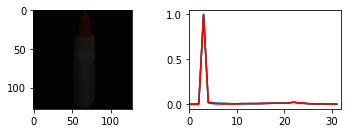

In [58]:
path_image_query = "./coil-100/obj33__95.png"

query = prepareQuery(path_image_query = path_image_query)

In [59]:
query.head()

,X_0,X_1,X_2,X_3,X_4,X_5,X_6,X_7,X_8,X_9,...,X_45,X_46,X_47,X_48,X_49,X_50,X_51,X_52,X_53,X_54
0,obj33__95.png,-0.4979310631752014,-0.2399957925081253,-0.0925920158624649,-0.002193862572312355,0.07712358981370926,0.022310445085167885,-0.05955448001623154,0.03205897659063339,0.039341628551483154,...,-0.00622379407286644,0.0028623444959521294,0.0025099744088947773,0.0014856327325105667,0.001848055049777031,0.00024432409554719925,0.003372503910213709,-0.00011417653877288103,-22.01599054169412,-10.214734326738888


In [60]:
kd_tree.get_KNN(query)

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.041 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.032 secondes
temps de recherche: 0.074 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.022 secondes
temps de recherche: 0.042 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.044 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.075 secondes
temps de recherche: 0.167 secondes
temps de recherche: 0.356 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.102 secondes
temps de recherche: 0.102 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.103 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.104 secondes
temps de recherche: 0.108 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

In [61]:
res = kd_tree.afficheResultats(image_query = path_image_query)

> recherche  --input  ./coil-100/obj33__95.png 

Images                     Distances
------                     ---------
obj33__285.png		 0.2623726725578308

obj15__325.png		 0.29450488090515137

obj84__170.png		 0.3276247978210449

obj33__210.png		 0.3320022523403168

obj33__205.png		 0.3407459557056427

obj33__175.png		 0.38003548979759216

obj33__290.png		 0.38884443044662476

obj22__270.png		 0.3961254358291626

obj33__170.png		 0.39832863211631775

obj33__165.png		 0.4019118547439575

obj33__105.png		 0.4152778089046478

obj84__195.png		 0.42750608921051025

obj20__25.png		 0.4556887447834015

obj33__180.png		 0.4606458246707916

obj84__165.png		 0.4636416435241699



In [62]:
print(kd_tree.tree.properties)

{'height': 12, 'size': 7200, 'is_max_heap': False, 'is_min_heap': False, 'is_perfect': False, 'is_strict': False, 'is_complete': False, 'leaf_count': 3105, 'min_node_value': -0.462, 'max_node_value': 0.523, 'min_leaf_depth': 12, 'max_leaf_depth': 12, 'is_bst': False, 'is_balanced': True, 'is_symmetric': False}


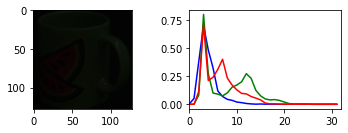

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

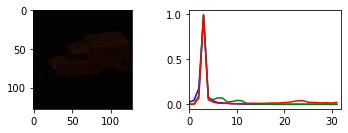

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.076 secondes
temps de recherche: 0.177 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.017 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

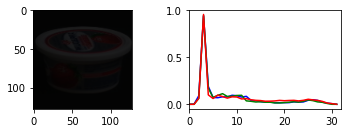

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.022 secondes
temps de recherche: 0.039 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.075 secondes
temps de recherche: 0.166 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.024 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

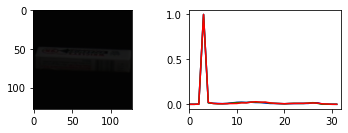

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.039 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.025 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.024 secondes
temps de recherche: 0.047 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.027 secondes
temps de recherche: 0.070 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.040 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.084 secondes
temps de recherche: 0.184 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

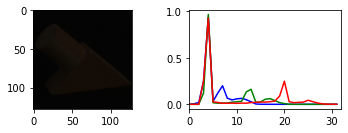

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.031 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.039 secondes
temps de recherche: 0.081 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.010 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.013 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

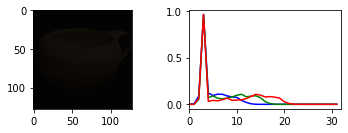

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.024 secondes
temps de recherche: 0.071 secondes
temps de recherche: 0.151 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.022 secondes
temps de recherche: 0.045 secondes
temps de recherche: 0.090 secondes
temps de recherche: 0.177 secondes
temps de recherche: 0.358 secondes
temps de recherche: 0.364 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.027 secondes
temps de recherche: 0.045 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

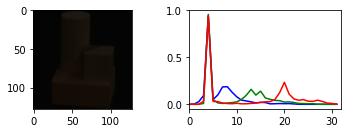

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.024 secondes
temps de recherche: 0.069 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

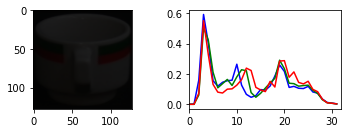

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.018 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

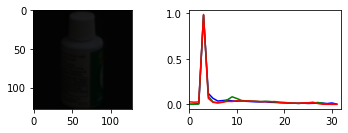

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.029 secondes
temps de recherche: 0.045 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.021 secondes
temps de recherche: 0.051 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.022 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

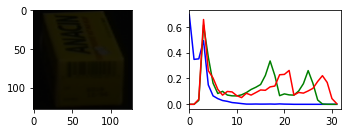

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.029 secondes
temps de recherche: 0.052 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

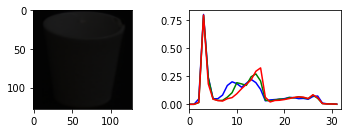

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.040 secondes


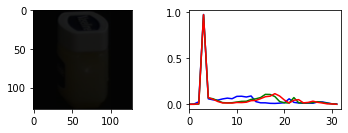

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.038 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.012 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.025 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

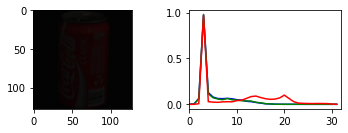

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.024 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.032 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.016 secondes
temps de recherche: 

temps de recherche: 0.008 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.012 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

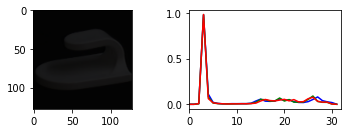

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.022 secondes
temps de recherche: 0.038 secondes
temps de recherche: 0.090 secondes
temps de recherche: 0.183 secondes
temps de recherche: 0.339 secondes
temps de recherche: 0.632 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.031 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

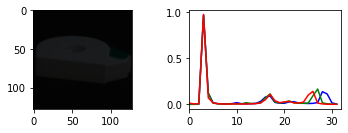

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.024 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.028 secondes
temps de recherche: 0.045 secondes
temps de recherche: 0.080 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.038 secondes
temps de recherche: 0.072 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

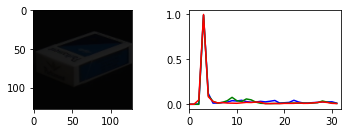

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.078 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.014 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

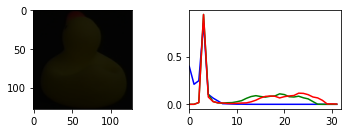

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.031 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.042 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.029 secondes
temps de recherche: 0.070 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

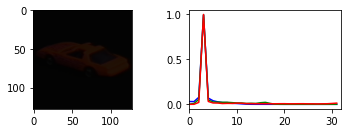

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.074 secondes
temps de recherche: 0.141 secondes
temps de recherche: 0.291 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.016 secondes
temps de recherche: 

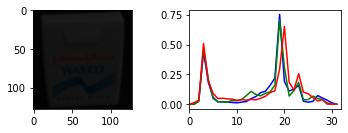

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.045 secondes
temps de recherche: 0.076 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

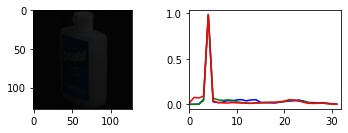

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.016 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

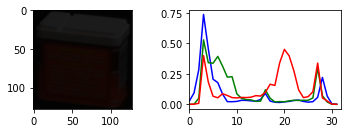

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

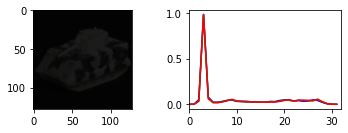

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.024 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.024 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

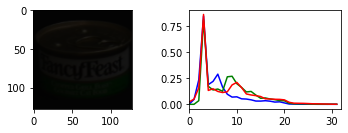

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 

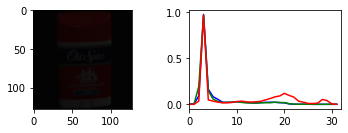

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.103 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

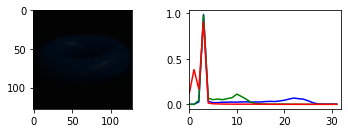

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

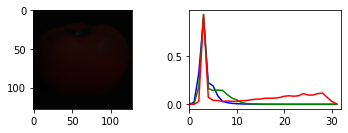

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

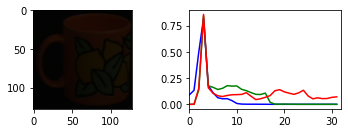

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

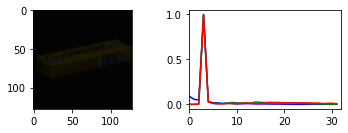

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.011 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

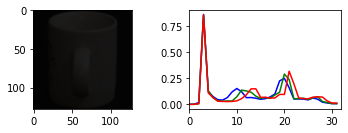

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.069 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.075 secondes
temps de recherche: 0.146 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

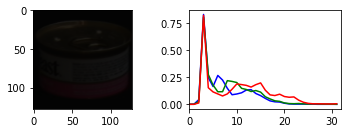

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

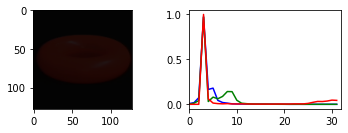

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.035 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.028 secondes
temps de recherche: 0.065 secondes
temps de recherche: 0.136 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.030 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

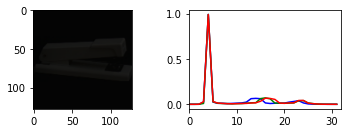

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.072 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

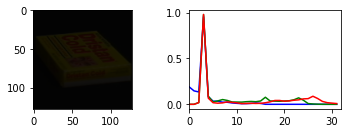

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.029 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.028 secondes
temps de recherche: 0.060 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

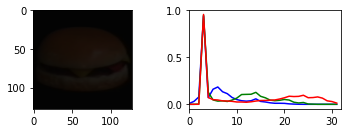

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.041 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.025 secondes
temps de recherche: 0.045 secondes
temps de recherche: 0.079 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

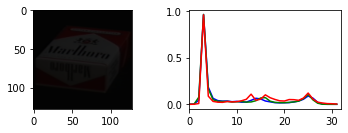

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.069 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.039 secondes
temps de recherche: 0.070 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.030 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

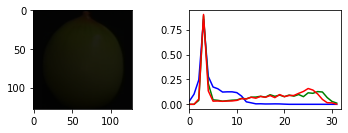

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.129 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.029 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

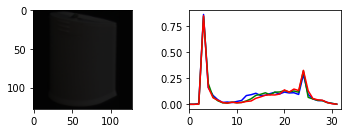

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.067 secondes
temps de recherche: 0.147 secondes
temps de recherche: 0.303 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

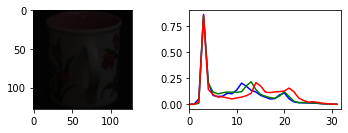

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

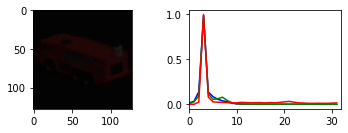

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.030 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.016 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

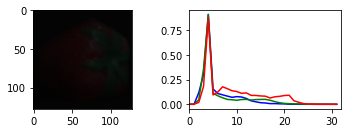

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

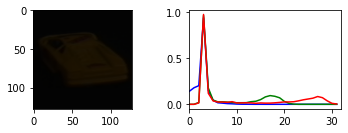

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.028 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.043 secondes
temps de recherche: 0.084 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.072 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

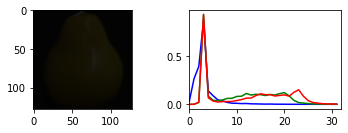

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.028 secondes
temps de recherche: 0.059 secondes
temps de recherche: 0.082 secondes
temps de recherche: 0.153 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.044 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.020 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

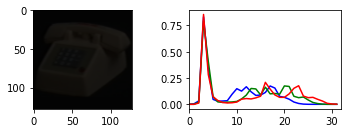

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

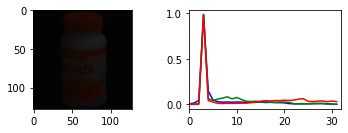

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.055 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.032 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.038 secondes
temps de recherche: 0.068 secondes
temps de recherche: 0.147 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

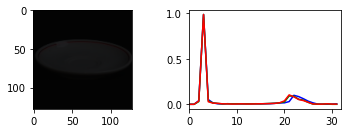

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.024 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

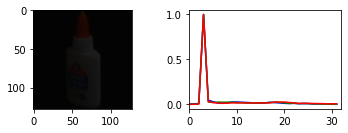

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.032 secondes
temps de recherche: 0.063 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.022 secondes
temps de recherche: 

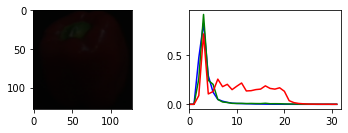

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

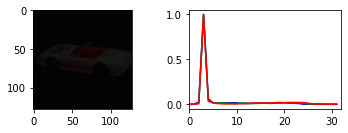

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.011 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.025 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.025 secondes
temps de recherche: 0.060 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.067 secondes
temps de recherche: 

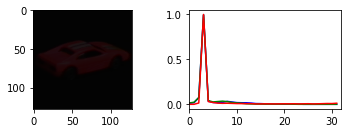

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.013 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.028 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.031 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.027 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

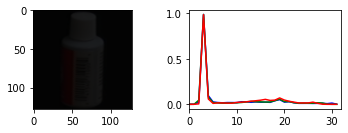

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.041 secondes
temps de recherche: 0.074 secondes
temps de recherche: 0.144 secondes
temps de recherche: 0.314 secondes
temps de recherche: 0.622 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.016 secondes
temps de recherche: 

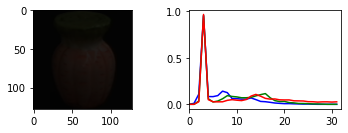

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.025 secondes
temps de recherche: 0.042 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.018 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.022 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.010 secondes
temps de recherche: 0.022 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.075 secondes
temps de recherche: 0.150 secondes
temps de recherche: 0.314 secondes
temps de recherche: 0.628 secondes
temps de recherche: 1.276 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

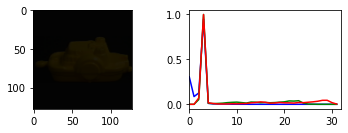

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.023 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.040 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.028 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

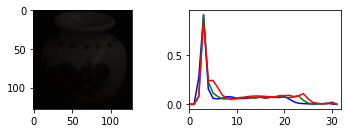

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.035 secondes
temps de recherche: 0.070 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.031 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

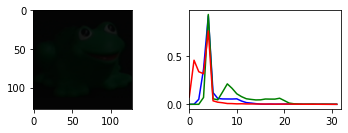

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

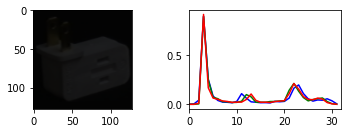

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.022 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

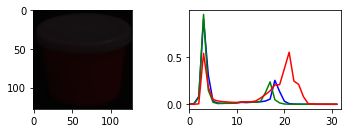

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.071 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.027 secondes
temps de recherche: 0.043 secondes
temps de recherche: 0.079 secondes
temps de recherche: 0.149 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

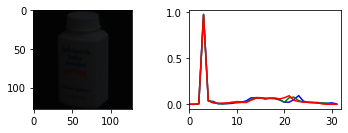

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.009 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.017 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

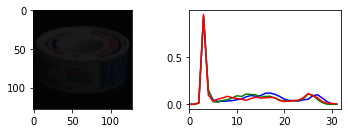

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

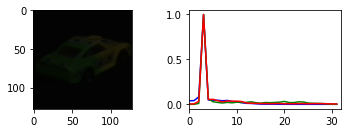

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.011 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.032 secondes
temps de recherche: 0.070 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.029 secondes
temps de recherche: 0.065 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.031 secondes
temps de recherche: 0.065 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.017 secondes
temps de recherche: 

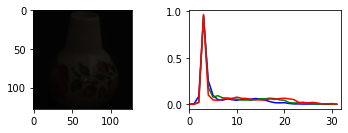

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.070 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.031 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

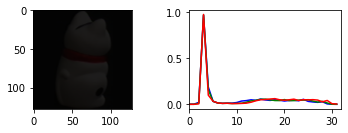

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.005 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.029 secondes
temps de recherche: 0.068 secondes
temps de recherche: 0.130 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.016 secondes
temps de recherche: 

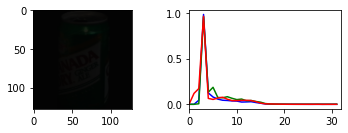

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.068 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.012 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.032 secondes
temps de recherche: 

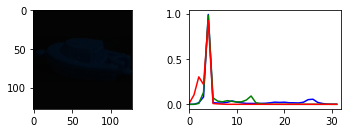

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.030 secondes
temps de recherche: 0.063 secondes
temps de recherche: 0.131 secondes
temps de recherche: 0.277 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

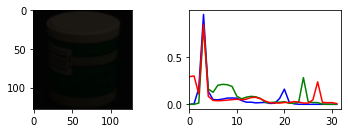

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.016 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.063 secondes
temps de recherche: 0.130 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.012 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

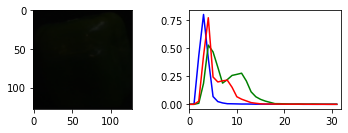

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.229 secondes
temps de recherche: 0.249 secondes


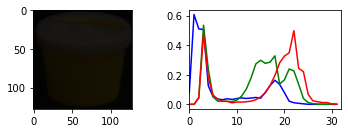

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.074 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

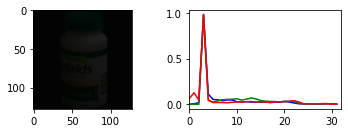

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.018 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.016 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.027 secondes
temps de recherche: 0.065 secondes
temps de recherche: 0.137 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

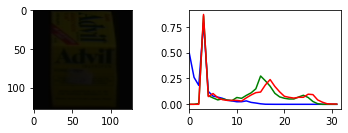

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

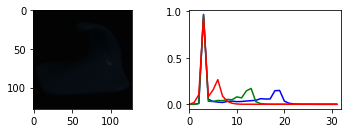

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

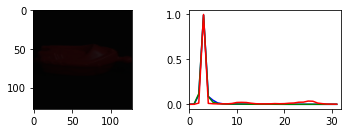

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.022 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.111 secondes
temps de recherche: 0.111 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.112 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.113 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.116 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

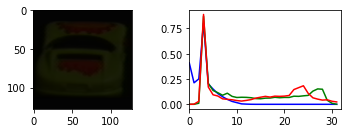

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.028 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.070 secondes
temps de recherche: 0.139 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

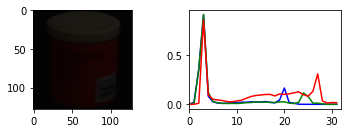

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.031 secondes
temps de recherche: 0.071 secondes
temps de recherche: 

temps de recherche: 0.023 secondes
temps de recherche: 0.057 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.017 secondes
temps de recherche: 

temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.030 secondes
temps de recherche: 0.066 secondes
temps de recherche: 0.136 secondes
temps de recherche: 0.290 secondes
temps de recherche: 

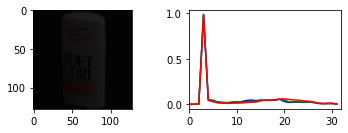

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.009 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

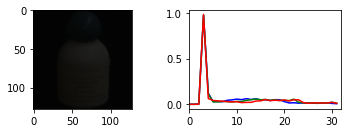

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.007 secondes
temps de recherche: 

temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.032 secondes
temps de recherche: 0.065 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.022 secondes
temps de recherche: 0.056 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.031 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

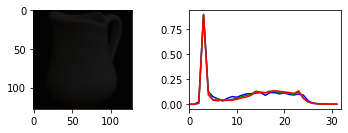

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.039 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.041 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.024 secondes
temps de recherche: 0.054 secondes
temps de recherche: 0.122 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.024 secondes
temps de recherche: 0.047 secondes
temps de recherche: 0.102 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

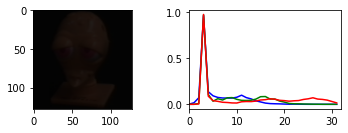

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.031 secondes
temps de recherche: 0.063 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

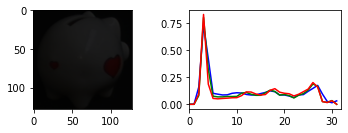

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.019 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.017 secondes
temps de recherche: 

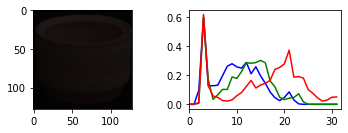

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.011 secondes
temps de recherche: 

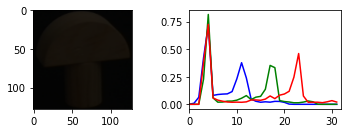

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

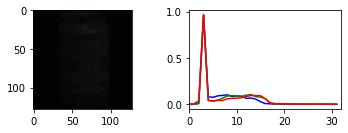

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.074 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.034 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

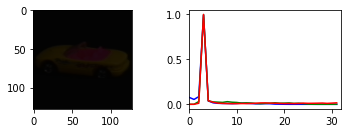

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.071 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.017 secondes
temps de recherche: 

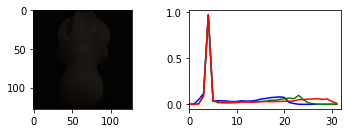

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.026 secondes
temps de recherche: 0.061 secondes
temps de recherche: 0.139 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

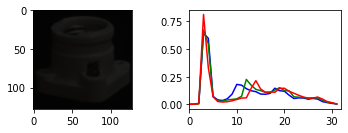

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.022 secondes
temps de recherche: 0.041 secondes
temps de recherche: 0.075 secondes
temps de recherche: 0.174 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

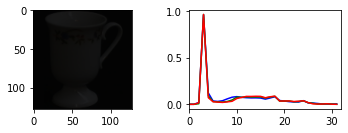

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.074 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

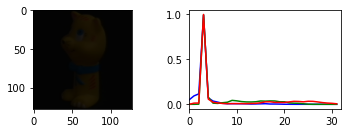

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.010 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.017 secondes
temps de recherche: 

temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.032 secondes
temps de recherche: 0.071 secondes
temps de recherche: 0.131 secondes
temps de recherche: 0.276 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

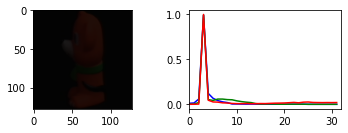

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

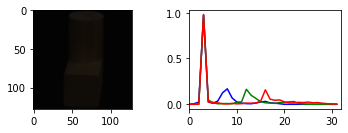

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.071 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

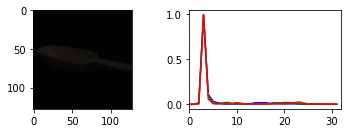

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.010 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

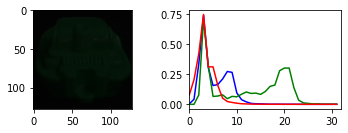

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

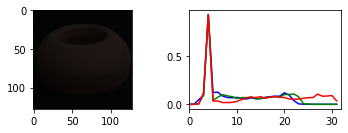

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

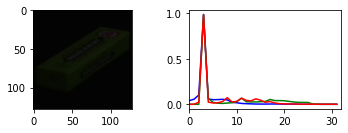

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.024 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.024 secondes
temps de recherche: 0.045 secondes
temps de recherche: 0.080 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.044 secondes
temps de recherche: 0.070 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

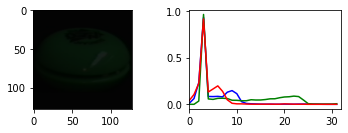

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.032 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.015 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

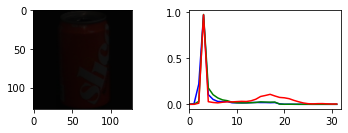

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.022 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.030 secondes
temps de recherche: 0.069 secondes
temps de recherche: 0.139 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.029 secondes
temps de recherche: 0.064 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.022 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.016 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.075 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.015 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

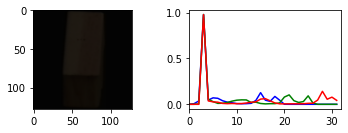

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.042 secondes
temps de recherche: 0.080 secondes
temps de recherche: 0.186 secondes
temps de recherche: 0.311 secondes
temps de recherche: 0.614 secondes
temps de recherche: 1.271 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.015 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

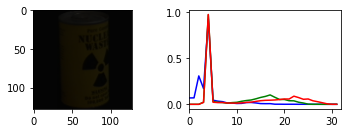

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.069 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

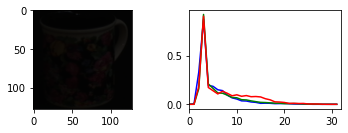

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.081 secondes
temps de recherche: 0.143 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.038 secondes
temps de recherche: 0.063 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.028 secondes
temps de recherche: 0.064 secondes
temps de recherche: 

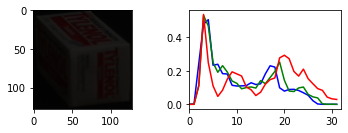

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

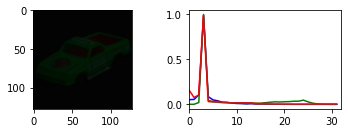

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.031 secondes
temps de recherche: 0.066 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

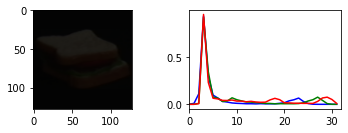

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.039 secondes
temps de recherche: 0.070 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

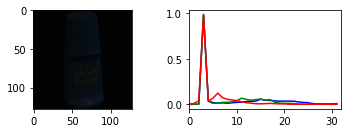

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.012 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 

In [63]:
kdt_conf_matrix = kd_tree.evaluate()

In [64]:
# matrice confusion
kdt_conf_matrix

array([[1., 0., 0., ..., 0., 0., 0.],
       [1., 1., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       ...,
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 5.]])

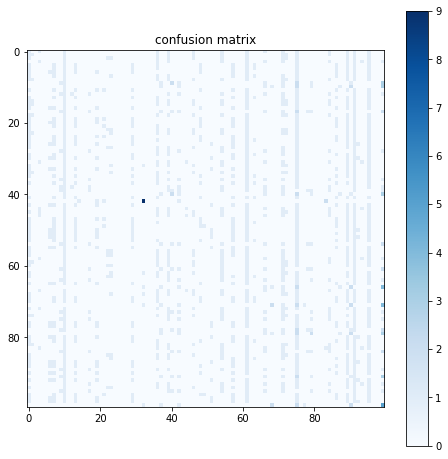

In [65]:
draw(cf=kdt_conf_matrix)

In [66]:
get_accuracy(cf=kdt_conf_matrix)

Accuracy d'évaluation:  3.3333333333333335%
Erreur d'évaluation: 96.66666666666667%


## Test sur quelques images requête

#### Test_ 1: image requete tasse. Nous obtenons 1 bon resultat proche de notre image requête. l

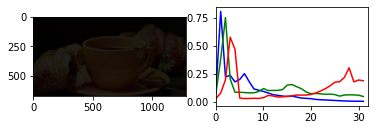

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.071 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.015 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.029 secondes
temps de recherche: 0.067 secondes
temps de recherche: 0.142 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.021 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

In [67]:
# image requete tasse
path_image_query = "./samples/tasse3.jpg"

query = prepareQuery(path_image_query=path_image_query)

kd_tree.get_KNN(query)
res = kd_tree.afficheResultats(path_image_query)

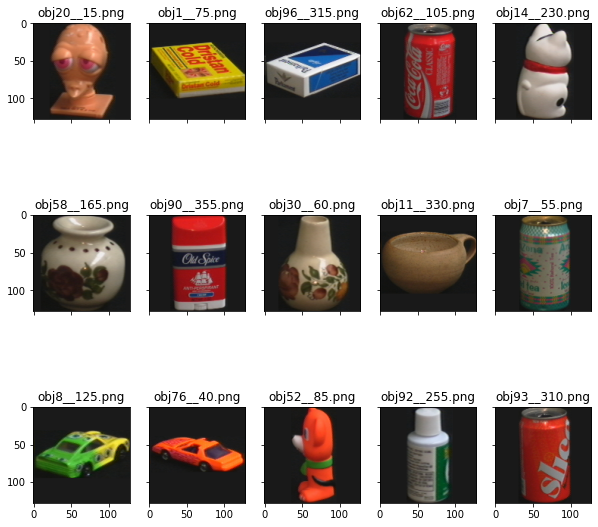

In [68]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

#### Test_ 2: image requete tasse. Nous obtenons 1 bon resultat proche de notre image requête

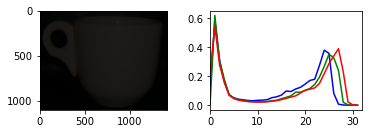

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.018 secondes
temps de recherche: 0.039 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.022 secondes
temps de recherche: 0.044 secondes
temps de recherche: 0.079 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.033 secondes
temps de recherche: 0.073 secondes
temps de recherche: 0.144 secondes
temps de recherche: 0.298 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

In [69]:
# image requete tasse
path_image_query = "./samples/tasse.png"

query = prepareQuery(path_image_query=path_image_query)

kd_tree.get_KNN(query)
res = kd_tree.afficheResultats(path_image_query)

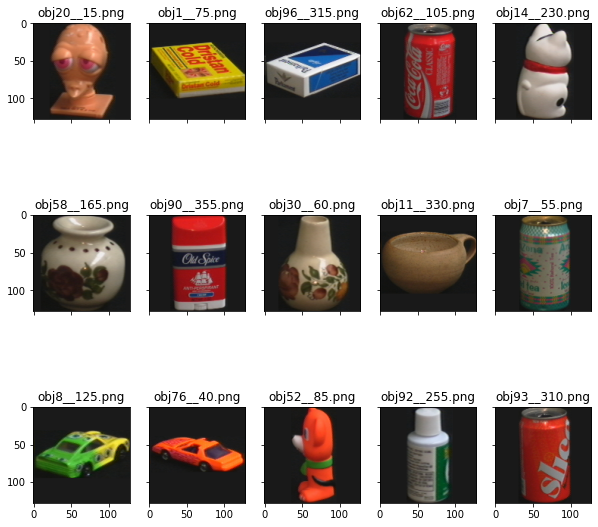

In [70]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

#### Test_ 3: image requete hambourger. Nous obtenons aucun bons resultats proche de notre image requête

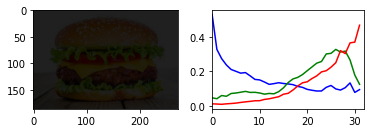

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.014 secondes
temps de recherche: 0.020 secondes
temps de recherche: 0.032 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.019 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.040 secondes
temps de recherche: 0.069 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.058 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.016 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

In [71]:
# image requete tasse
path_image_query = "./samples/hambourger.jpeg"

query = prepareQuery(path_image_query=path_image_query)

kd_tree.get_KNN(query)
res = kd_tree.afficheResultats(path_image_query)

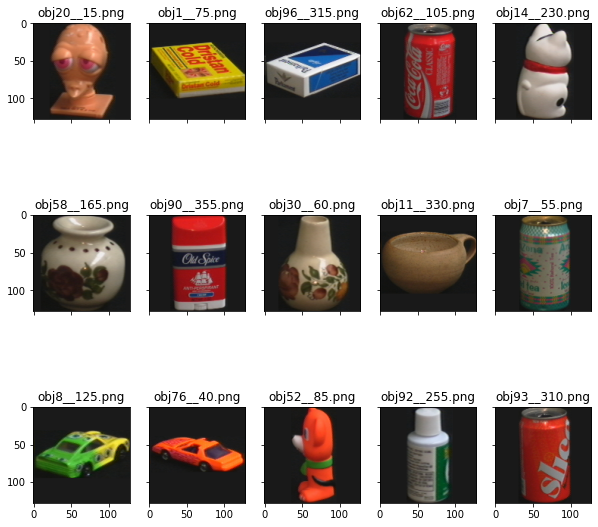

In [72]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

#### Test_ 4: image requete automobile. Nous obtenons aucun bons resultats proche de notre image requête

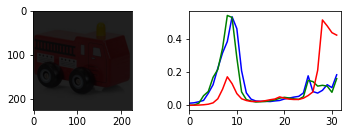

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.025 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.034 secondes
temps de recherche: 0.069 secondes
temps de recherche: 0.169 secondes
temps de recherche: 0.287 secondes
temps de recherche: 0.637 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.036 secondes
temps de recherche: 0.066 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.012 secondes
temps de recherche: 0.023 secondes
temps de recherche: 0.037 secondes
temps de recherche: 0.071 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

In [73]:
# image requete tasse
path_image_query ="./samples/bus.jpeg"

query = prepareQuery(path_image_query=path_image_query)

kd_tree.get_KNN(query)
res = kd_tree.afficheResultats(path_image_query)

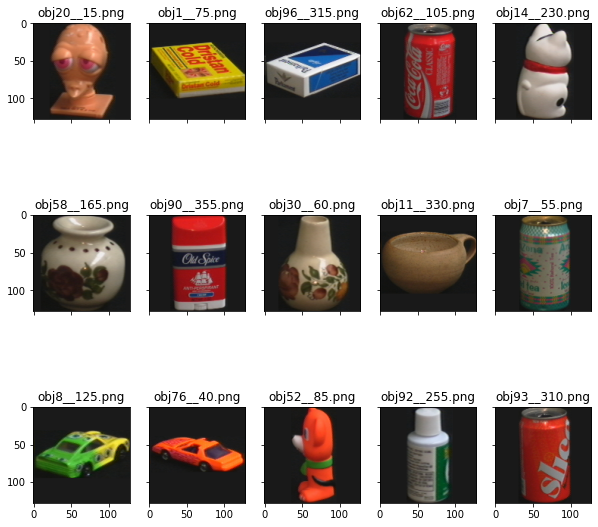

In [74]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

#### Test_ 5: image requete canette coca. Nous obtenons 2 bons resultats proche de notre image requête

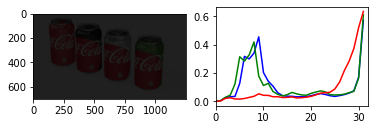

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.010 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.035 secondes
temps de recherche: 0.070 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.011 secondes
temps de recherche: 0.017 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.009 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.005 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.007 secondes
temps de recherche: 0.013 secondes
temps de recherche: 0.032 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.006 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.002 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.004 secondes
temps de recherche: 0.008 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.000 secondes
temps de recherche: 0.001 secondes
temps de recherche: 0.003 secondes
temps de recherche: 0.000 secondes
temps de recherche: 

In [75]:
# image requete tasse
path_image_query = "./samples/canettecoca.jpg"

query = prepareQuery(path_image_query=path_image_query)

kd_tree.get_KNN(query)
_res = kd_tree.afficheResultats(path_image_query)

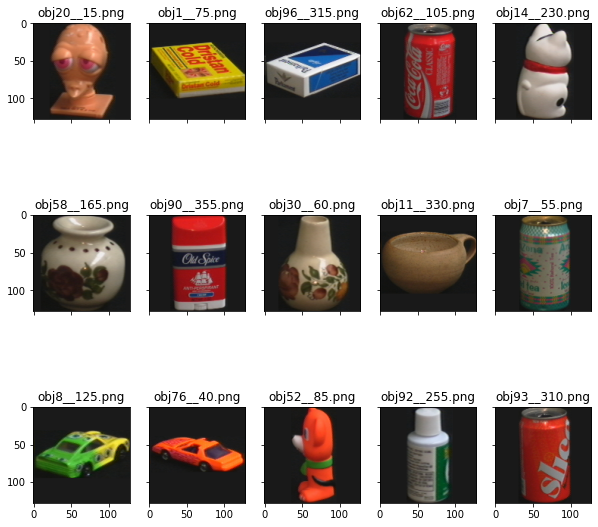

In [76]:
# Visualiser les résulatas
AfficherResultats(resultats = _res)

## Conclusion: KD-Tree
### La méthode est  rapide, le nombre de calcul est réduite grace à cette structure pour la recherche, mais moins précise soit en moyenne 3.4% sur notre base d'évaluation. Nous avons opté pour la distance euclidienne comme métrique de similarités, car très meilleur que celle définit au préalable, après reduction de dimensions (PCA), pour dimunuer le temps de calcul.  
### Les jeux de test, non pas de donner de bons résultats, le modèle c'est beaucoup trompé sur la forme que la couleur.

In [77]:
_db = db_df.copy()

In [78]:
del _db['X_0']

In [79]:
_db

,X_1,X_2,X_3,X_4,X_5,X_6,X_7,X_8,X_9,X_10,...,X_45,X_46,X_47,X_48,X_49,X_50,X_51,X_52,X_53,X_54
0,-0.24551032483577728,0.04424871876835823,0.0652414932847023,-0.06900810450315475,-0.04607217013835907,-0.040863193571567535,-0.06827889382839203,0.05500771850347519,-0.02508840337395668,0.1076759546995163,...,-0.008001635782420635,0.007296987809240818,-0.001571016851812601,-4.752752374770353e-06,0.0022558525670319796,0.0032349538523703814,-0.0005534352385438979,0.008305247873067856,-20.760095210974445,-10.91365236183969
1,-0.37485215067863464,-0.16084247827529907,-0.03493546321988106,0.008492322638630867,-0.03858628123998642,0.07130929082632065,-0.05581536144018173,0.040403109043836594,-0.028717001900076866,0.006352574098855257,...,0.0057045528665184975,-0.00021566481154877692,0.007578677032142878,0.006679983343929052,0.011851227842271328,-0.0020544370636343956,0.008653894998133183,-0.003010792890563607,-18.63289334790968,-8.335880238525997
2,-0.35484644770622253,-0.07213401049375534,0.005778567865490913,0.04917726293206215,-0.10743241757154465,0.0810004472732544,-0.1044389083981514,-0.006601844914257526,0.0008943231077864766,-0.03260250762104988,...,-0.003458762774243951,-0.02188669890165329,-0.012297947891056538,-0.009394362568855286,-0.01205709669739008,-0.0044657643884420395,-0.010425283573567867,-0.0056868139654397964,-20.34046210489856,-10.650191752116928
3,0.19467288255691528,0.6835078001022339,-0.07906823605298996,-0.3564893305301666,0.08947400748729706,-0.13005061447620392,-0.12242569029331207,0.015844687819480896,0.025229673832654953,-0.11021152883768082,...,0.04988357424736023,0.010683177039027214,-0.04075445607304573,0.03510967269539833,-0.045545801520347595,0.008808066137135029,0.006193997338414192,-0.015933580696582794,-19.657880077201234,28.679453781496843
4,-0.21030974388122559,0.11285331100225449,0.2646639943122864,-0.08602362871170044,-0.08525913208723068,-0.06415029615163803,-0.10105627775192261,-0.013098502531647682,-0.03136172890663147,-0.05684423819184303,...,0.0034450122620910406,0.01594332419335842,-0.014414306730031967,0.02025749534368515,-0.007591185625642538,0.016091810539364815,0.02425002120435238,-0.008119569160044193,23.92978310227335,-18.135217633291692
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7195,-0.4823268949985504,-0.16609054803848267,-0.09101060777902603,0.15120190382003784,0.06386375427246094,-0.066864974796772,-0.04878837615251541,0.03480479493737221,0.01736171543598175,0.010405324399471283,...,0.004133667331188917,-0.002335822442546487,-0.009173969738185406,-0.010855092667043209,-0.01000656932592392,-0.002506930148229003,-0.004004766698926687,0.004417425952851772,-21.9761636733757,-0.3456840910026647
7196,-0.331072062253952,-0.0797325000166893,0.0076616546139121056,-8.24145827209577e-05,-0.10876023769378662,0.016616571694612503,-0.07877811044454575,-0.006839844863861799,0.009201779961585999,-0.04443388804793358,...,-0.007692729588598013,-0.0014365802053362131,-0.011404676362872124,-0.00394927803426981,-0.003910246305167675,0.008619765751063824,-0.007422913797199726,-0.006330985110253096,-23.26793084606831,-13.176815110919392
7197,0.43703776597976685,0.08968076854944229,0.4575079083442688,0.029233234003186226,-0.1575552076101303,-0.06551363319158554,-0.009249542839825153,-0.09035726636648178,0.09550146758556366,-0.15196967124938965,...,-0.014658422209322453,-0.012497621588408947,-0.016712775453925133,-0.00953631941229105,0.008065254427492619,0.03448401018977165,-0.020491281524300575,0.0015170496189966798,-13.250908548549152,37.03888299149956
7198,-0.14132694900035858,0.10341453552246094,-0.060355667024850845,-0.09551718086004257,-0.02937781624495983,0.04735451936721802,0.3223193287849426,0.07215867191553116,0.0017967625753954053,0.06078850105404854,...,0.003924703225493431,-0.01459761057049036,-0.004710803274065256,0.02292342483997345,-0.03385746479034424,0.03015861287713051,-0.025108307600021362,-0.01590152643620968,22.47386139729091,-17.96139769

## ----------------------------------------------------------------------
## __Step__ 2 : Indexation par clustering: K-means

In [80]:
class KMEANS:
    def __init__(self, n_cluster = 1, data = None, labels = None):
        self.num_clusters = n_cluster
        self.centers = None
        self.data = data
        self.list_inerties = list()
        self.list_distorsions = list()
        self.clusters = None
        self.db_name_file = labels
        self.resultats = list()
    
    # determiner le nombre de clusters avec la méthode de coude (elbow method)
    def check_cluster_num(self):
    
        print("N_Clusters\t inerties\t  distortions")
        k_range = range(1, 20)
        for k in k_range:
            model = KMeans(n_clusters=k).fit(self.data)
            inertie = model.inertia_
            self.list_inerties.append(inertie)
            dist = sum(np.min(cdist(self.data, model.cluster_centers_,'euclidean'), axis=1)) / self.data.shape[0]
            self.list_distorsions.append(dist)
            print(k, "\t",inertie, "\t", dist)

        plt.subplot(221), plt.plot(k_range, self.list_inerties), plt.title("Clusters inerties"), plt.xlabel('Nombre de clusters'),plt.ylabel('Coût du model')
        plt.subplot(222), plt.plot(k_range, self.list_distorsions), plt.title("Clusters distorsions"),plt.xlabel('Nombre de clusters')

        plt.xlim([1, len(k_range)])
        
        plt.show()
        
        
    # mettre à jour le nombre de clusters
    def setNbCluster(self, n_cluster):
        self.num_clusters = n_cluster
        
        
    # retourner les centroides de chaque n_cluster    
    def kmeans_clustering(self):
        model = KMeans(n_clusters=self.num_clusters, random_state=1500).fit(self.data)
        self.centers = model.cluster_centers_     
    
    # assosiciation de chaque features à un cluster, en calculant les distances 
    # pour chaque feature aux centroides, et l'associe (label) au centroide de distance minimale
    def features_clusters_labels(self):
        model = AgglomerativeClustering(n_clusters=self.num_clusters, affinity='euclidean', linkage='ward')
        model.fit(self.data)
        self.clusters = pairwise_distances_argmin(self.data, self.centers)
        
    
    # recherche à partir image requête
    def searchFromQuery(self, query ): 
        # temps debut
        start = time.time()
        dist_for_centroid = []
        for centroid in self.centers:
            dist = np.linalg.norm(np.asarray(centroid, dtype=np.float32) - np.asarray(query.values[0][1:], dtype=np.float32))
            dist_for_centroid.append(dist)
        
        # recupérer le centroide le plus proche de l'image requête (de distance minimale)
        best_centroid_cluster = np.argmin(dist_for_centroid)
        # parcourir le data, pour chaque entrée appartenant au cluster, on calcule 
        # sa distance ecleudienne au query,puis elle est retenu si inférieur 0.5
        for i,ft in enumerate(self.data):
            if best_centroid_cluster == self.clusters[i]:
                dist = np.linalg.norm(np.asarray(ft, dtype=np.float32) - np.asarray(query.values[0][1:], dtype=np.float32))
                # mesure de similarité couleur (52 dim) et forme (2 dim) de l'image requête
                #d_color = Chi2Distance(features_color_db = np.asarray(ft[:52], dtype=np.float32), features_color_query = np.asarray(query.values[0][1:53], dtype=np.float32))
                #d_shape = DistanceEuclidienne(features_shape_db =np.asarray(ft[52:], dtype=np.float32) , features_shape_query = np.asarray(query.values[0][53:], dtype=np.float32))

                # métrique globale
                #dist = Distance(dist_color=d_color, dist_shape=d_shape)
                self.resultats.append([self.db_name_file[i], dist])
        # temps fin
        end = time.time()
        print("temps de recherche: {:.3f} secondes".format(end-start))
        
                    
    # afficher resultats
    def afficheResultats(self,image_query, k_neighbors = 15, display = True):
        # trier liste resultats
        resultats = sorted(self.resultats, key=lambda res_entry: res_entry[1]) 
        list_files = []
        # retourner les 15 meilleurs resultats (distance minimale)
        resultats = resultats[:15]
        if display:
            print("> recherche  --input  {}".format(image_query),"\n")
            print("Images                     Distances")
            print("------                     ---------")
        for res in resultats :
            list_files.append(res[0])
            if display:
                print("{}\t\t {}\n".format(res[0], res[1]))
        
        return list_files
    
    """ Elvaluation sur 100 images requête (1 image/classe)
        La fonction evaluate, retourne une matrice de confusion de taille 100 x 100, 
        chaque ligne correspond à l'image de test utilisé, et les colonnes vont contenir le nombre d'occurence pour chaque image resultat parmi 10.
    """
    def evaluate(self,test = test_path):
        # temps debut
        start = time.time()
        cf = np.zeros((100,100))
        images_filenames_test  =  glob.glob( test_path +'*.png')
        # faire la recherche pour chaque image de test et mettre à jour la matrice de confusion
        for fname_test in images_filenames_test:
            # recupérer l'id de l'image test
            id_test = getId(fname_test)
            # preparer la requête
            query = prepareQuery(path_image_query=fname_test)
            # recherche d'images similaires
            self.searchFromQuery(query)
            # obtenir resultats
            resultats_noms = self.afficheResultats(fname_test, display=False)
            # Mise à jour de la matrice de confusion
            cf = UpdateConfMatrix(cf = cf, id_test = id_test, resultats = resultats_noms)
        # temps fin
        end  = time.time()
        print("temps d'évaluation: {:.4} secondes".format(end-start))
        # returner la matrice de confusion
        return cf

In [81]:
k_means = KMEANS(data=np.asarray(_db.values, dtype=np.float32), labels=db_df['X_0'].values.tolist())

N_Clusters	 inerties	  distortions
1 	 7196642.072967529 	 30.460192830559492
2 	 3509152.8012956847 	 19.076920446386342
3 	 1292810.9653601786 	 9.46227689348763
4 	 237695.87944562582 	 4.673805196102639
5 	 188422.21683952227 	 4.1273412787880694
6 	 149310.18640873852 	 3.602519442779148
7 	 108823.7210343624 	 3.114553284437204
8 	 73513.80532643059 	 2.653901155171405
9 	 55039.464428240244 	 2.2865653853239034
10 	 44301.78008813402 	 2.077211939929935
11 	 39856.63676172827 	 1.954314851698374
12 	 35567.775900894194 	 1.883113376527289
13 	 31342.02997418759 	 1.7959653657833106
14 	 27994.722878750643 	 1.6933761639772082
15 	 25774.908855263162 	 1.6096693010672865
16 	 24277.474539884814 	 1.5613909194445226
17 	 22973.904301739927 	 1.5431267228475136
18 	 21803.120547171242 	 1.4813160803814942
19 	 19912.66785962887 	 1.447811671040193


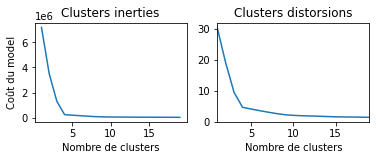

In [82]:
 k_means.check_cluster_num()

In [83]:
# mis à jour du nombre de clusters
k_means.setNbCluster(n_cluster=8)

In [84]:
k_means.num_clusters

8

In [85]:
# Entraintement et determination des centroides
k_means.kmeans_clustering()

In [86]:
# centroides
k_means.centers.shape

(8, 54)

In [87]:
k_means.centers

array([[ 1.02749646e-01,  4.84509245e-02,  5.25160357e-02,
         7.81316962e-03, -2.45279968e-02,  3.60912010e-02,
         3.74803022e-02,  1.76328328e-02, -3.10793123e-03,
         2.58782860e-02, -2.25511305e-02, -9.80615523e-03,
        -1.44970277e-02,  1.93652473e-02, -1.86633749e-03,
         1.47856064e-02,  5.15718432e-03,  8.67600273e-03,
         4.48363833e-04, -1.43481244e-03,  1.61962991e-03,
         6.82509039e-04, -1.12907467e-02,  3.53868515e-03,
         1.19188838e-02,  6.29845494e-03,  7.41481548e-03,
        -8.01117349e-05, -2.61628465e-03,  9.01091285e-03,
         5.30708069e-03, -5.69091225e-03,  5.86204790e-03,
        -3.34401894e-03, -6.39114482e-03,  1.40446809e-03,
        -2.40673427e-03, -5.63973852e-04, -1.10962882e-03,
        -2.67496589e-03,  1.44807750e-03,  2.43592332e-03,
         2.45782291e-03,  1.94502948e-03, -1.70392275e-03,
        -1.74005853e-03, -7.43063516e-04, -4.15409869e-03,
        -3.79198138e-03, -3.75297014e-03, -5.71428915e-0

### Nous verifions également le nombre de clusters possibles, par une classification hierarchique. La méthode de dendogram de la librairie scipy.cluster, prend en paramètres nos données et la méthode ward, afin minimiser la variance de distance entre les clusters.  Nous concluons que le meilleur nombre de clusters est également 4. 

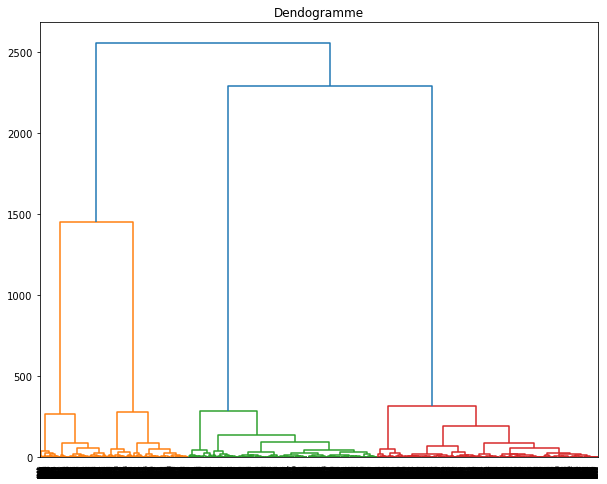

In [88]:
plt.figure(figsize=(10, 8))
plt.title("Dendogramme")
dend = shc.dendrogram(shc.linkage(_db.values, method='ward'))

### Maintenant que nous connaissons le nombre de clusters (4) pour notre ensemble de données, l'étape suivante consiste à regrouper les points de données dans ces cinq clusters. Pour ce faire, nous utiliserons à nouveau la classe AgglomerativeClustering de la bibliothèque sklearn.cluster.  

In [89]:
k_means.features_clusters_labels()

In [90]:
# données labelisés respectivement par le numéro des clusters (0-3)
print(k_means.clusters, k_means.clusters.shape)

[4 4 4 ... 2 1 3] (7200,)


In [91]:
k_means.clusters[:20]

array([4, 4, 4, 5, 1, 2, 5, 1, 2, 1, 1, 3, 6, 4, 1, 0, 4, 2, 3, 1])

#### Visualisation des clusters, en fonction des 2 composantes features formes obtenues après PCA

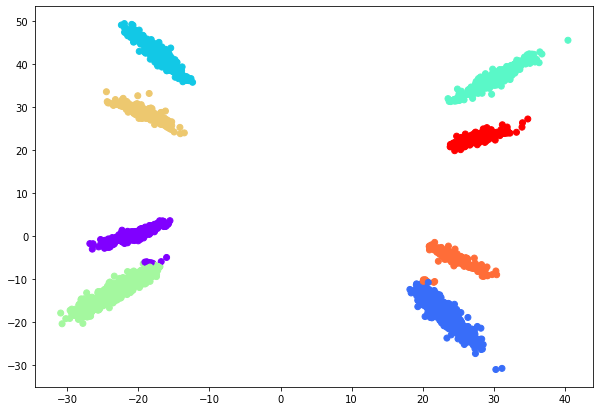

In [92]:
plt.figure(figsize=(10, 7))
plt.scatter(k_means.data[:,52], k_means.data[:,53], c=k_means.clusters, cmap='rainbow')

#####  Recherche à partir image requête

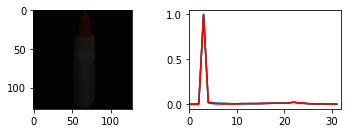

In [93]:
path_image_query = "./coil-100/obj33__95.png"

query = prepareQuery(path_image_query = path_image_query)

In [94]:
k_means.searchFromQuery(query)

temps de recherche: 0.166 secondes


In [95]:
res = k_means.afficheResultats(path_image_query)

> recherche  --input  ./coil-100/obj33__95.png 

Images                     Distances
------                     ---------
obj33__95.png		 8.386909655655472e-08

obj33__100.png		 0.14077283442020416

obj33__285.png		 0.2623726725578308

obj15__325.png		 0.29450488090515137

obj84__170.png		 0.3276247978210449

obj33__210.png		 0.3320022523403168

obj33__205.png		 0.3407459557056427

obj33__175.png		 0.38003548979759216

obj33__290.png		 0.38884443044662476

obj22__270.png		 0.3961254358291626

obj33__170.png		 0.39832863211631775

obj33__165.png		 0.4019118547439575

obj33__105.png		 0.4152778089046478

obj33__280.png		 0.42273813486099243

obj84__195.png		 0.42750608921051025



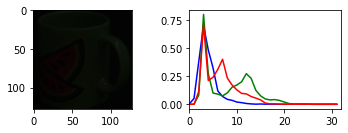

temps de recherche: 0.045 secondes


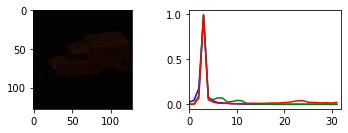

temps de recherche: 0.125 secondes


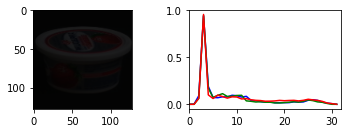

temps de recherche: 0.024 secondes


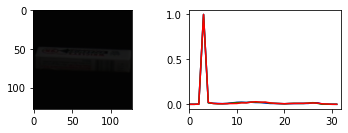

temps de recherche: 0.154 secondes


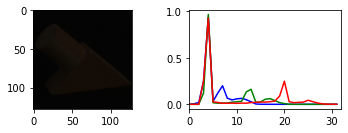

temps de recherche: 0.050 secondes


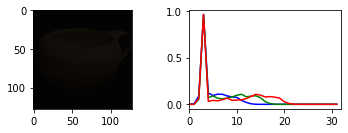

temps de recherche: 0.038 secondes


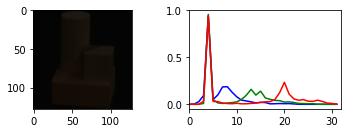

temps de recherche: 0.129 secondes


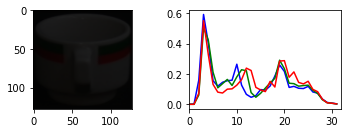

temps de recherche: 0.046 secondes


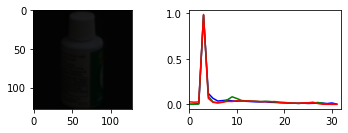

temps de recherche: 0.472 secondes


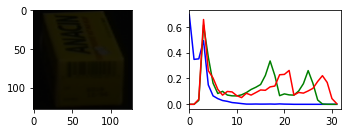

temps de recherche: 0.133 secondes


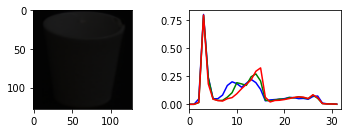

temps de recherche: 0.046 secondes


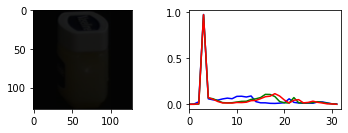

temps de recherche: 0.148 secondes


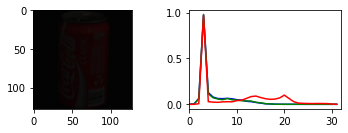

temps de recherche: 0.145 secondes


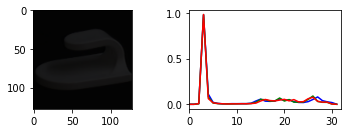

temps de recherche: 0.157 secondes


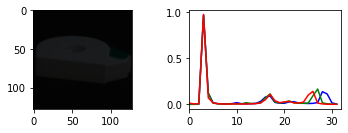

temps de recherche: 0.156 secondes


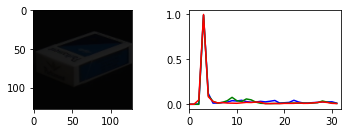

temps de recherche: 0.160 secondes


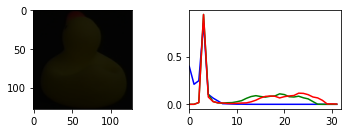

temps de recherche: 0.128 secondes


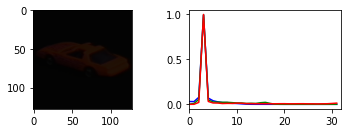

temps de recherche: 0.133 secondes


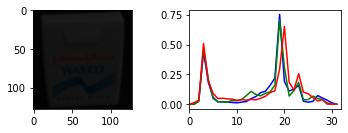

temps de recherche: 0.150 secondes


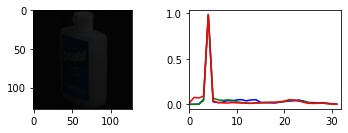

temps de recherche: 0.290 secondes


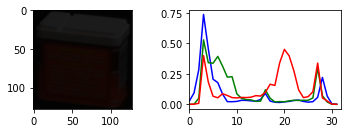

temps de recherche: 0.026 secondes


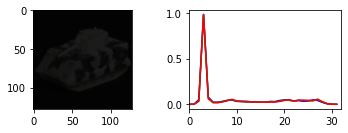

temps de recherche: 0.019 secondes


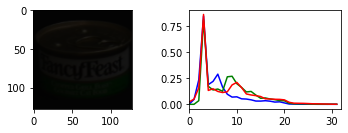

temps de recherche: 0.126 secondes


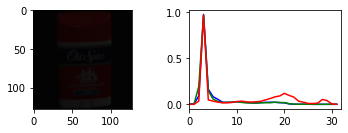

temps de recherche: 0.154 secondes


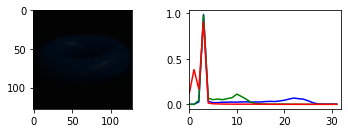

temps de recherche: 0.155 secondes


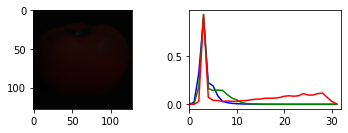

temps de recherche: 0.044 secondes


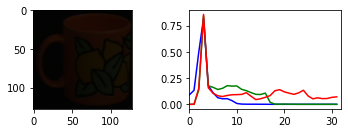

temps de recherche: 0.040 secondes


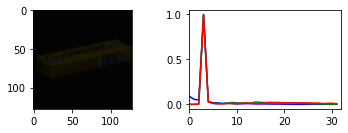

temps de recherche: 0.126 secondes


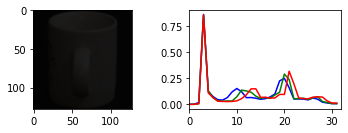

temps de recherche: 0.156 secondes


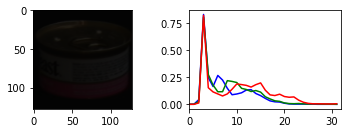

temps de recherche: 0.158 secondes


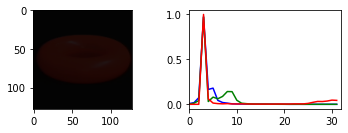

temps de recherche: 0.048 secondes


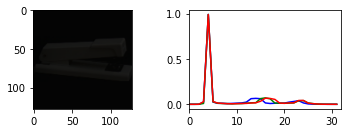

temps de recherche: 0.128 secondes


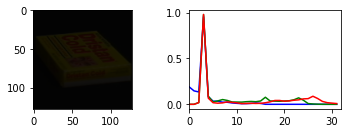

temps de recherche: 0.276 secondes


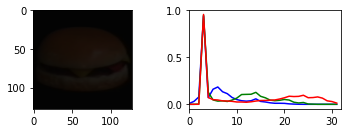

temps de recherche: 0.052 secondes


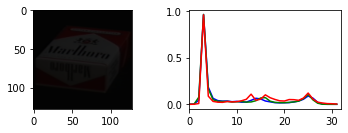

temps de recherche: 0.136 secondes


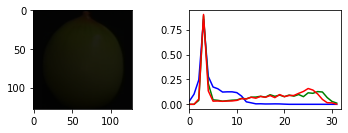

temps de recherche: 0.045 secondes


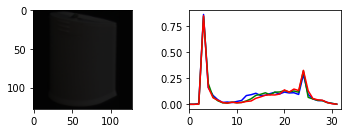

temps de recherche: 0.040 secondes


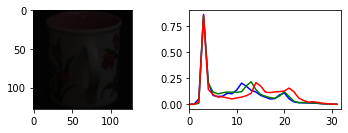

temps de recherche: 0.163 secondes


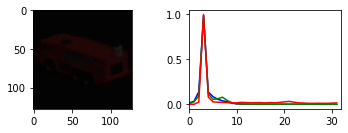

temps de recherche: 0.126 secondes


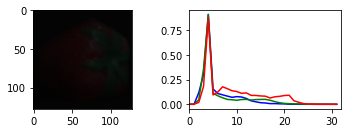

temps de recherche: 0.152 secondes


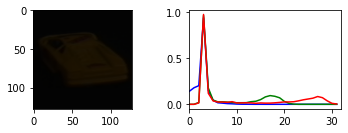

temps de recherche: 0.128 secondes


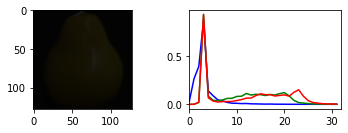

temps de recherche: 0.159 secondes


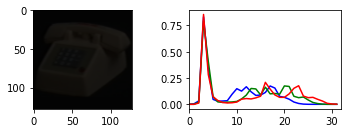

temps de recherche: 0.158 secondes


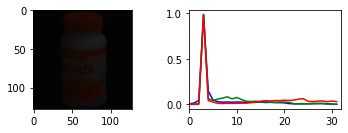

temps de recherche: 0.151 secondes


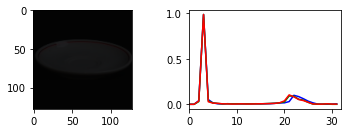

temps de recherche: 0.042 secondes


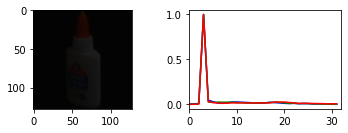

temps de recherche: 0.270 secondes


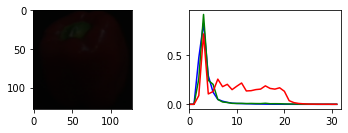

temps de recherche: 0.053 secondes


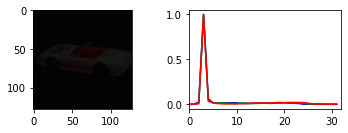

temps de recherche: 0.132 secondes


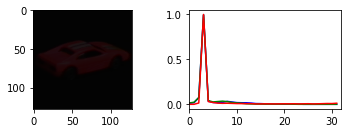

temps de recherche: 0.110 secondes


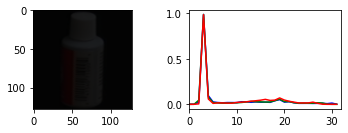

temps de recherche: 0.165 secondes


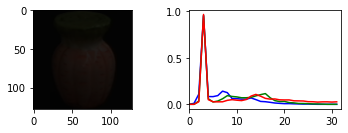

temps de recherche: 0.131 secondes


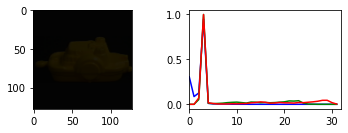

temps de recherche: 0.126 secondes


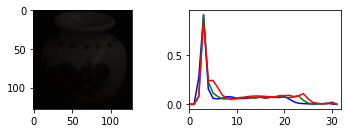

temps de recherche: 0.046 secondes


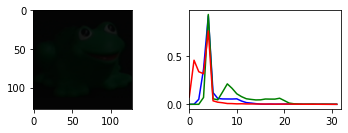

temps de recherche: 0.040 secondes


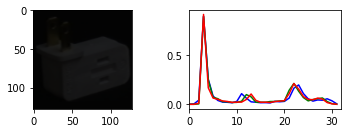

temps de recherche: 0.132 secondes


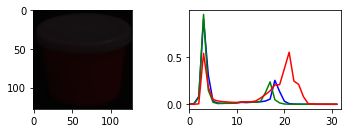

temps de recherche: 0.149 secondes


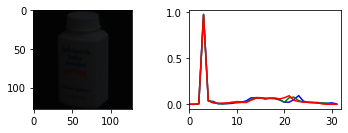

temps de recherche: 0.142 secondes


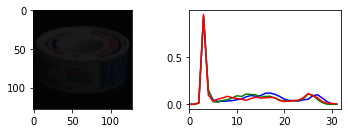

temps de recherche: 0.024 secondes


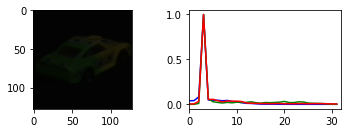

temps de recherche: 0.131 secondes


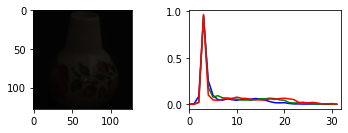

temps de recherche: 0.315 secondes


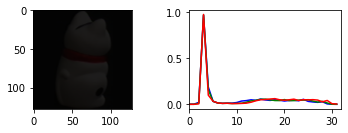

temps de recherche: 0.123 secondes


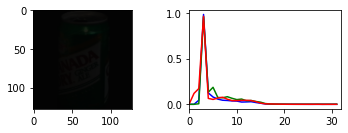

temps de recherche: 0.157 secondes


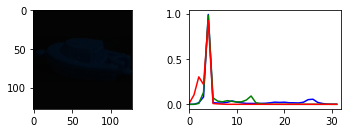

temps de recherche: 0.023 secondes


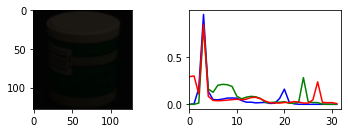

temps de recherche: 0.155 secondes


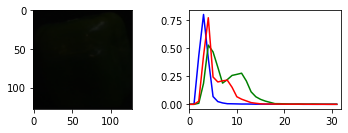

temps de recherche: 0.041 secondes


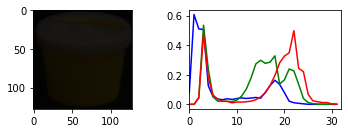

temps de recherche: 0.025 secondes


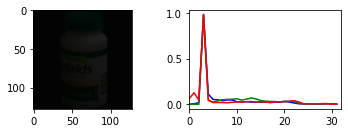

temps de recherche: 0.157 secondes


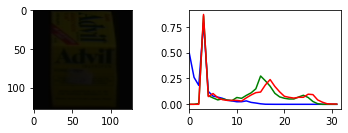

temps de recherche: 0.169 secondes


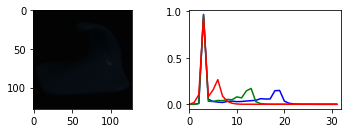

temps de recherche: 0.045 secondes


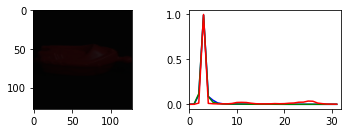

temps de recherche: 0.136 secondes


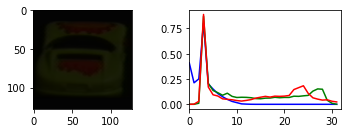

temps de recherche: 0.023 secondes


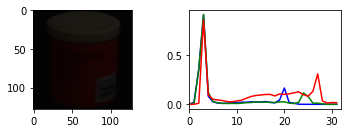

temps de recherche: 0.146 secondes


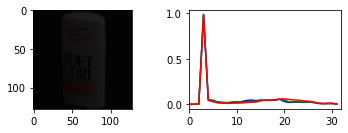

temps de recherche: 0.151 secondes


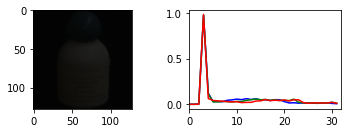

temps de recherche: 0.127 secondes


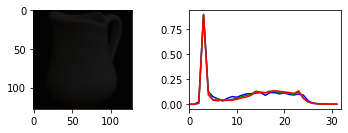

temps de recherche: 0.285 secondes


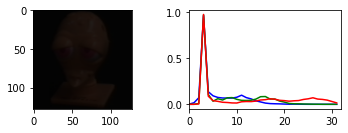

temps de recherche: 0.138 secondes


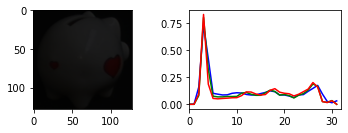

temps de recherche: 0.042 secondes


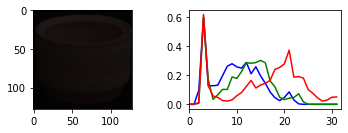

temps de recherche: 0.154 secondes


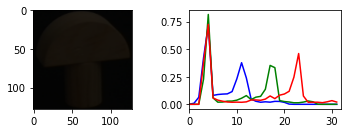

temps de recherche: 0.124 secondes


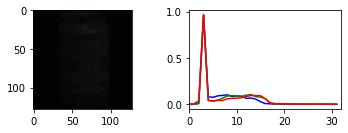

temps de recherche: 0.064 secondes


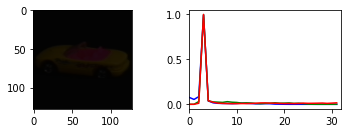

temps de recherche: 0.044 secondes


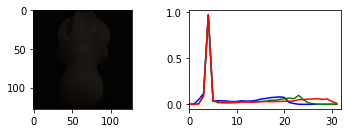

temps de recherche: 0.126 secondes


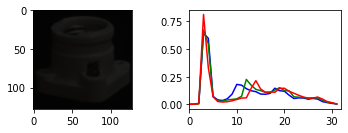

temps de recherche: 0.039 secondes


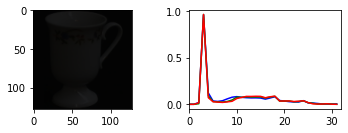

temps de recherche: 0.151 secondes


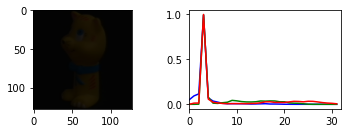

temps de recherche: 0.152 secondes


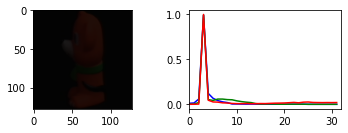

temps de recherche: 0.150 secondes


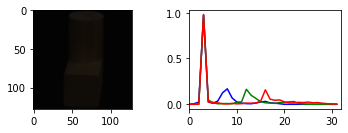

temps de recherche: 0.112 secondes


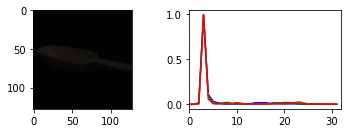

temps de recherche: 0.167 secondes


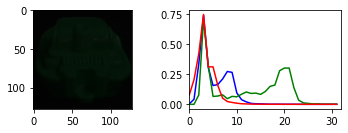

temps de recherche: 0.040 secondes


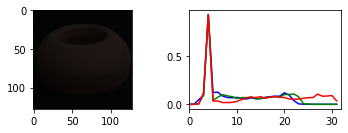

temps de recherche: 0.022 secondes


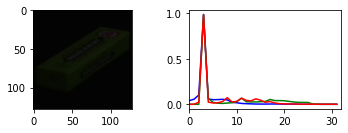

temps de recherche: 0.031 secondes


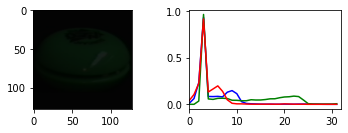

temps de recherche: 0.151 secondes


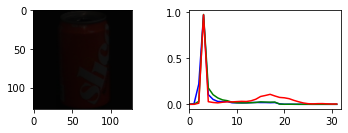

temps de recherche: 0.164 secondes


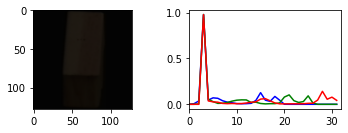

temps de recherche: 0.151 secondes


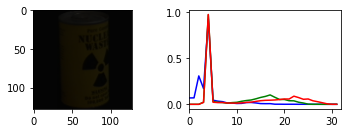

temps de recherche: 0.130 secondes


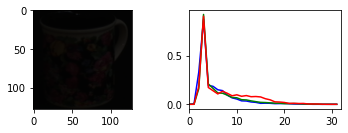

temps de recherche: 0.157 secondes


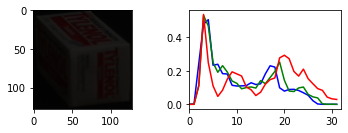

temps de recherche: 0.130 secondes


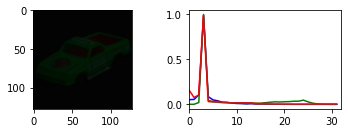

temps de recherche: 0.151 secondes


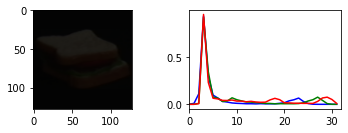

temps de recherche: 0.158 secondes


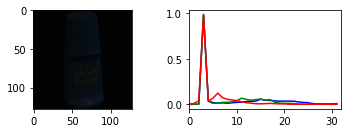

temps de recherche: 0.127 secondes
temps d'évaluation: 71.9 secondes


In [96]:
km_conf_matrix = k_means.evaluate()

In [97]:
# matrice confusion
km_conf_matrix

array([[1., 0., 0., ..., 0., 0., 0.],
       [1., 1., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       ...,
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 4.]])

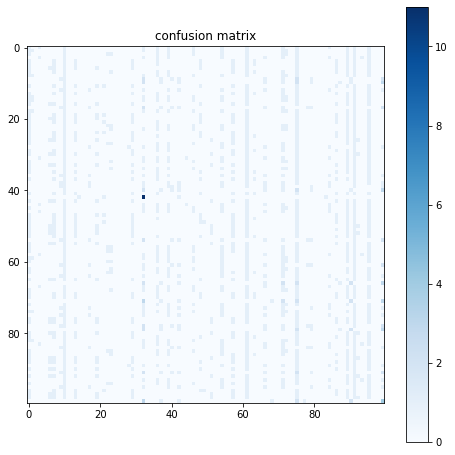

In [98]:
draw(cf=km_conf_matrix)

In [99]:
get_accuracy(cf=km_conf_matrix)

Accuracy d'évaluation:  3.1333333333333333%
Erreur d'évaluation: 96.86666666666667%


### Tests sur images externes

#### Test_ 1: image requete tasse.  Nous obtenons 2 images de tasses resultats proche de notre image requête.

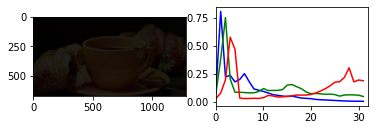

temps de recherche: 0.153 secondes
> recherche  --input  ./samples/tasse3.jpg 

Images                     Distances
------                     ---------
obj20__15.png		 3.97961770204347e-08

obj1__75.png		 4.025480748737209e-08

obj96__315.png		 4.2073562411815146e-08

obj62__105.png		 4.63201352829401e-08

obj14__230.png		 4.9171145377613357e-08

obj58__165.png		 5.805008385095789e-08

obj90__355.png		 6.052790979538258e-08

obj30__60.png		 6.083667614120714e-08

obj11__330.png		 6.24311837782443e-08

obj7__55.png		 6.303307031885197e-08

obj8__125.png		 6.328379242859228e-08

obj76__40.png		 6.357452519978324e-08

obj52__85.png		 6.4868018512243e-08

obj92__255.png		 6.604700075740766e-08

obj93__310.png		 6.648652828289414e-08



In [100]:
# image requete tasse
path_image_query = "./samples/tasse3.jpg"

query = prepareQuery(path_image_query=path_image_query)

k_means.searchFromQuery(query)
res = k_means.afficheResultats(path_image_query)

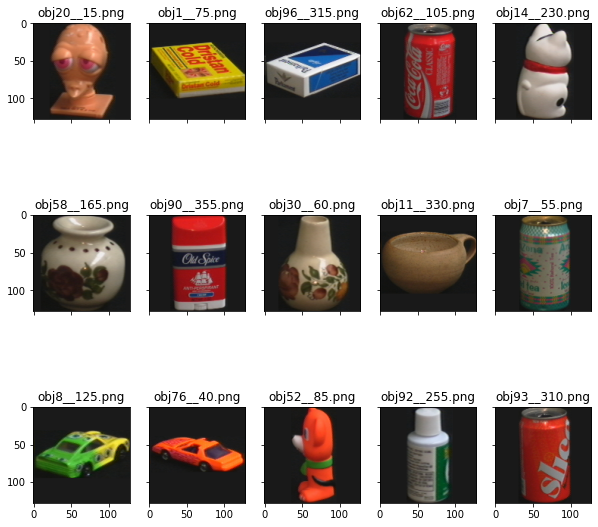

In [101]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

#### Test_ 2: image requete tasse. Resultats similaire au test précédent 

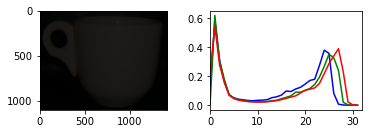

temps de recherche: 0.157 secondes
> recherche  --input  ./samples/tasse.png 

Images                     Distances
------                     ---------
obj20__15.png		 3.97961770204347e-08

obj1__75.png		 4.025480748737209e-08

obj96__315.png		 4.2073562411815146e-08

obj62__105.png		 4.63201352829401e-08

obj14__230.png		 4.9171145377613357e-08

obj58__165.png		 5.805008385095789e-08

obj90__355.png		 6.052790979538258e-08

obj30__60.png		 6.083667614120714e-08

obj11__330.png		 6.24311837782443e-08

obj7__55.png		 6.303307031885197e-08

obj8__125.png		 6.328379242859228e-08

obj76__40.png		 6.357452519978324e-08

obj52__85.png		 6.4868018512243e-08

obj92__255.png		 6.604700075740766e-08

obj93__310.png		 6.648652828289414e-08



In [102]:
# image requete tasse
path_image_query = "./samples/tasse.png"

query = prepareQuery(path_image_query=path_image_query)

k_means.searchFromQuery(query)
res = k_means.afficheResultats(path_image_query)

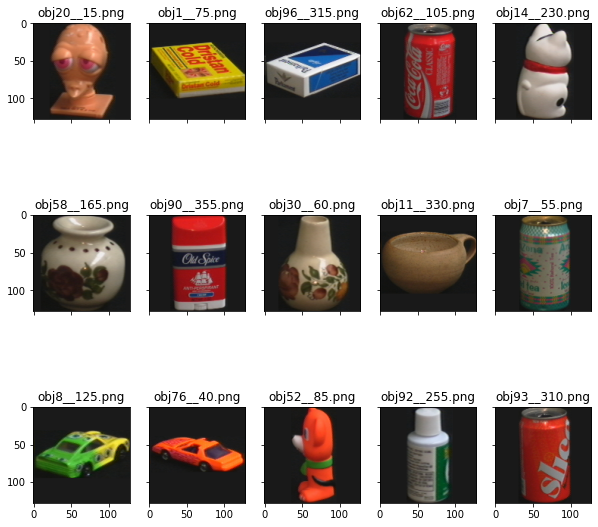

In [103]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

In [104]:
#### Test_ 3: image requete hambouger. Resultats similaire au test précédent 

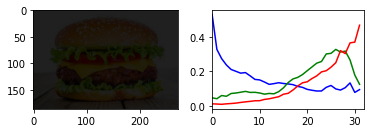

temps de recherche: 0.044 secondes
> recherche  --input  ./samples/hambourger.jpeg 

Images                     Distances
------                     ---------
obj20__15.png		 3.97961770204347e-08

obj1__75.png		 4.025480748737209e-08

obj96__315.png		 4.2073562411815146e-08

obj62__105.png		 4.63201352829401e-08

obj14__230.png		 4.9171145377613357e-08

obj58__165.png		 5.805008385095789e-08

obj90__355.png		 6.052790979538258e-08

obj30__60.png		 6.083667614120714e-08

obj11__330.png		 6.24311837782443e-08

obj7__55.png		 6.303307031885197e-08

obj8__125.png		 6.328379242859228e-08

obj76__40.png		 6.357452519978324e-08

obj52__85.png		 6.4868018512243e-08

obj92__255.png		 6.604700075740766e-08

obj93__310.png		 6.648652828289414e-08



In [105]:
# image requete tasse
path_image_query = "./samples/hambourger.jpeg"

query = prepareQuery(path_image_query=path_image_query)

k_means.searchFromQuery(query)
res = k_means.afficheResultats(path_image_query)

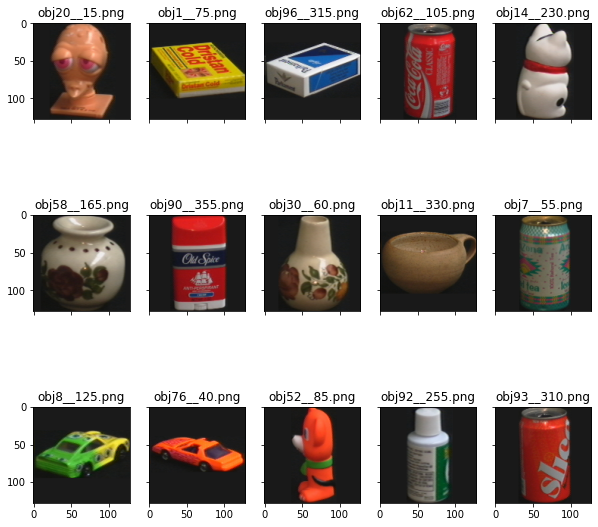

In [106]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

#### Test_ 4: image requete  automobile. Resultats similaire au test précédent 

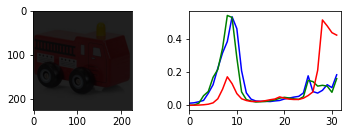

temps de recherche: 0.137 secondes
> recherche  --input  ./samples/bus.jpeg 

Images                     Distances
------                     ---------
obj20__15.png		 3.97961770204347e-08

obj1__75.png		 4.025480748737209e-08

obj96__315.png		 4.2073562411815146e-08

obj62__105.png		 4.63201352829401e-08

obj14__230.png		 4.9171145377613357e-08

obj58__165.png		 5.805008385095789e-08

obj90__355.png		 6.052790979538258e-08

obj30__60.png		 6.083667614120714e-08

obj11__330.png		 6.24311837782443e-08

obj7__55.png		 6.303307031885197e-08

obj8__125.png		 6.328379242859228e-08

obj76__40.png		 6.357452519978324e-08

obj52__85.png		 6.4868018512243e-08

obj92__255.png		 6.604700075740766e-08

obj93__310.png		 6.648652828289414e-08



In [107]:
# image requete tasse
path_image_query = "./samples/bus.jpeg"

query = prepareQuery(path_image_query=path_image_query)

k_means.searchFromQuery(query)
res = k_means.afficheResultats(path_image_query)

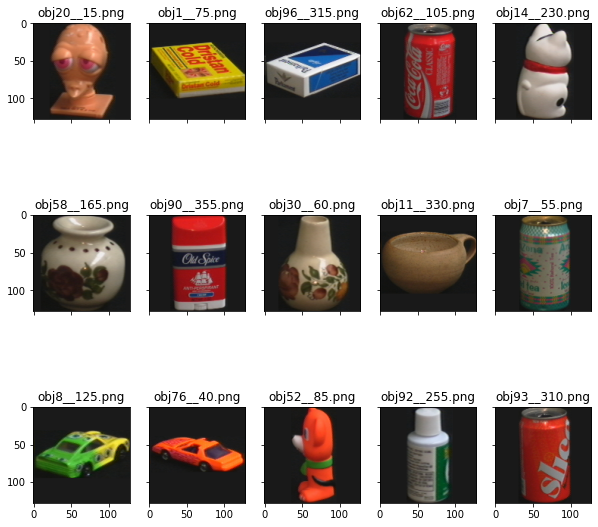

In [108]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

#### Test_ 5: image requete canette coca. Resultats similaire au test précédent

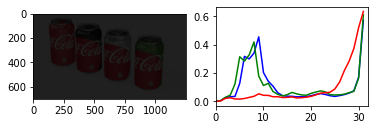

temps de recherche: 0.153 secondes
> recherche  --input  ./samples/canettecoca.jpg 

Images                     Distances
------                     ---------
obj20__15.png		 3.97961770204347e-08

obj1__75.png		 4.025480748737209e-08

obj96__315.png		 4.2073562411815146e-08

obj62__105.png		 4.63201352829401e-08

obj14__230.png		 4.9171145377613357e-08

obj58__165.png		 5.805008385095789e-08

obj90__355.png		 6.052790979538258e-08

obj30__60.png		 6.083667614120714e-08

obj11__330.png		 6.24311837782443e-08

obj7__55.png		 6.303307031885197e-08

obj8__125.png		 6.328379242859228e-08

obj76__40.png		 6.357452519978324e-08

obj52__85.png		 6.4868018512243e-08

obj92__255.png		 6.604700075740766e-08

obj93__310.png		 6.648652828289414e-08



In [109]:
# image requete tasse
path_image_query = "./samples/canettecoca.jpg"

query = prepareQuery(path_image_query=path_image_query)

k_means.searchFromQuery(query)
res = k_means.afficheResultats(path_image_query)

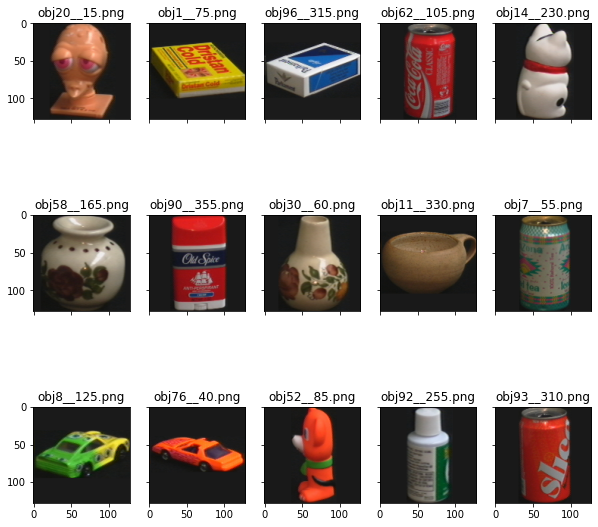

In [110]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

### Conclusion: K-means
### Nous avons constaté, initialement partant de 4 clusters, que les resultats images (en moyenne 1 bon/15) de l'image requête, étaient idenditiques pour toutes image prédite au sein d'un même centroide, cela malgré après avoir adopté la métrique unique de distance euclidienne. Alors 4 clusters ne dissociaient pas au mieux, nos features, avec une performance de 1,8%. Nous avons opté pour 8 clusters, pour une petite amélioration, en moyenne 3.14%, avec la métrique de similarité de distance euclidienne. 
### Nous pouvons conclu que nos images de tests son prédites dans pratiquement dans le même cluster, d'ou les resultats similaires. Le modèle est très dépend du nombre de clusters. On note pour un nombre de clusters supérieur à 8, le modèle se trompe encore plus au tant sur la forme que la couleur. 
## --------------------------------------------------------------------------------------------

## __Step__ 3 : Indexation par hachage: LSH (Locality Sensitive Hashing)
### Nous utilisons la librairie lshashpy3 (rapide pour le calcul de hash sur des données de grande dimensions), pour l'implemention

In [111]:
pip install lshashpy3

Note: you may need to restart the kernel to use updated packages.


In [112]:
from lshashpy3 import LSHash
from bitarray import bitarray

In [113]:
class LSHASH:
    def __init__(self, data, labels):
        self.data = data
        self.file_names = labels
        self.resultats = list()
        self.lsh = LSHash(hash_size= 10, input_dim= self.data.shape[1], 
                     num_hashtables= 5)
        
    # determiner le hash pour chaque feature
    def build_index(self):
        for i, ft in enumerate(self.data):
            self.lsh.index(np.asarray(ft, np.float), extra_data =self.file_names[i])
    
    
    """ recherche à partir image requête, similiraité entre deux haches, calculer à l'aide de la distance de
        hamming, retourne le nombre de bits differents entre les deux paires, 
        nous utilisons operateur XOR, qui retourne 1 si 2 bits sont differents
    """
    def dist_hamming(a,b):
        return np.sum(a!=b)
    
    def searchFromQuery(self, query):
        # temps debut
        start = time.time()
        res = self.lsh.query(np.asarray(query.values[0][1:], np.float32), distance_func="euclidean")
        self.resultats = [[file, dist] for ((vec, file), dist) in res]
        # temps fin
        end = time.time()
        print("temps de recherche: {:.3} secondes".format(end-start))

    
    # affiche resultats
    def afficheResultats(self,image_query, k_neighbors = 15, display = True):
        # trier liste resultats
        resultats = sorted(self.resultats, key=lambda res_entry: res_entry[1]) 
        list_files = []
        # retourner les 15 meilleurs resultats (distance minimale)
        resultats = resultats[:15]
        if display:
            print("> recherche  --input  {}".format(image_query),"\n")
            print("Images                     Distances")
            print("------                     ---------")
        for res in resultats :
            list_files.append(res[0])
            if display:
                print("{}\t\t {}\n".format(res[0], res[1]))

        return list_files
    
    
    """ Elvaluation sur 100 images requête (1 image/classe)
        La fonction evaluate, retourne une matrice de confusion de taille 100 x 100, 
        chaque ligne correspond à l'image de test utilisé, et les colonnes vont contenir le nombre d'occurence pour chaque image resultat parmi 10.
    """
    def evaluate(self,test = test_path):
        # temps debut
        start = time.time()
        cf = np.zeros((100,100))
        images_filenames_test  =  glob.glob( test_path +'*.png')
        # faire la recherche pour chaque image de test et mettre à jour la matrice de confusion
        for fname_test in images_filenames_test:
            # recupérer l'id de l'image test
            id_test = getId(fname_test)
            # preparer la requête
            query = prepareQuery(path_image_query=fname_test)
            # recherche d'images similaires
            self.searchFromQuery(query)
            # obtenir resultats
            resultats_noms = self.afficheResultats(fname_test, display=False)
            # Mise à jour de la matrice de confusion
            cf = UpdateConfMatrix(cf = cf, id_test = id_test, resultats = resultats_noms)
        
        # temps fin
        end = time.time()
        print("temps d'évaluation: {:.4} secondes".format(end-start))
        # returner la matrice de confusion
        return cf

In [114]:
LSH = LSHASH(np.asarray(_db, dtype=np.float32), db_df['X_0'].values.tolist())

In [115]:
LSH.build_index()

### Test sur une image requête

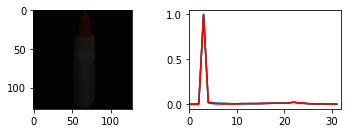

In [116]:
path_image_query = "./coil-100/obj33__95.png"

query = prepareQuery(path_image_query = path_image_query)

In [117]:
LSH.searchFromQuery(query)

temps de recherche: 0.0681 secondes


In [118]:
res = LSH.afficheResultats(path_image_query)

> recherche  --input  ./coil-100/obj33__95.png 

Images                     Distances
------                     ---------
obj33__95.png		 7.034025233004543e-15

obj33__100.png		 0.01981699205671114

obj33__285.png		 0.06883941917076368

obj15__325.png		 0.0867331236490168

obj84__170.png		 0.10733801434408564

obj33__210.png		 0.11022550068423212

obj33__205.png		 0.11610780737705437

obj33__175.png		 0.1444269595407583

obj33__290.png		 0.15119997855681272

obj22__270.png		 0.15691534911398686

obj33__170.png		 0.1586657072696944

obj33__165.png		 0.16153312973846412

obj33__105.png		 0.1724556661749308

obj33__280.png		 0.1787075367763245

obj84__195.png		 0.1827614523447894



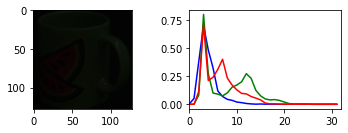

temps de recherche: 0.0296 secondes


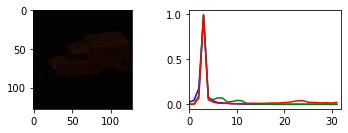

temps de recherche: 0.0599 secondes


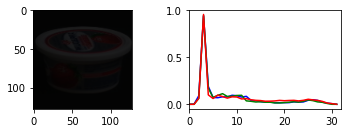

temps de recherche: 0.0509 secondes


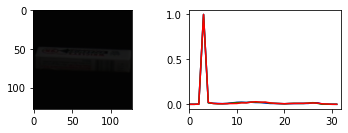

temps de recherche: 0.0554 secondes


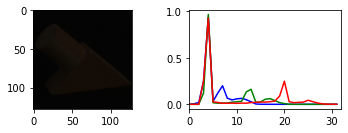

temps de recherche: 0.0273 secondes


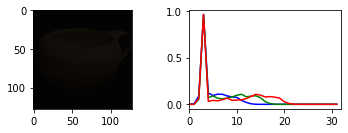

temps de recherche: 0.0304 secondes


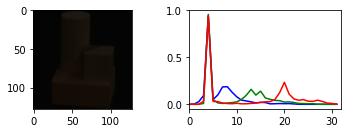

temps de recherche: 0.0539 secondes


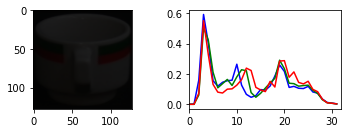

temps de recherche: 0.0276 secondes


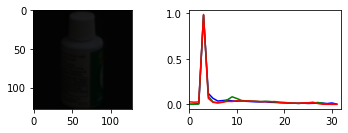

temps de recherche: 0.0539 secondes


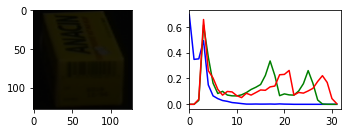

temps de recherche: 0.296 secondes


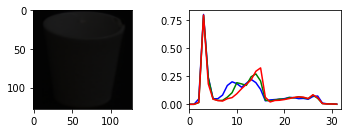

temps de recherche: 0.027 secondes


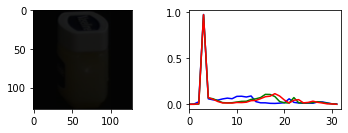

temps de recherche: 0.0548 secondes


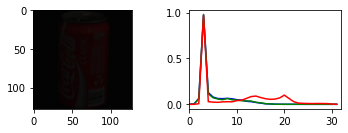

temps de recherche: 0.058 secondes


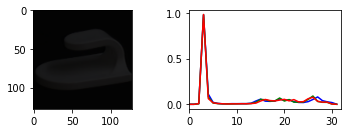

temps de recherche: 0.0546 secondes


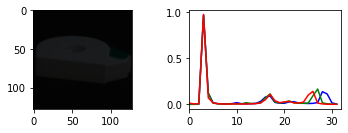

temps de recherche: 0.0547 secondes


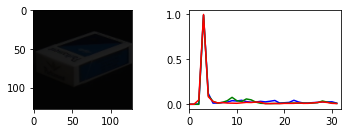

temps de recherche: 0.0588 secondes


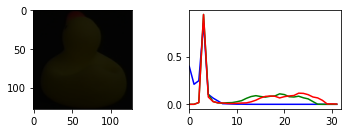

temps de recherche: 0.0592 secondes


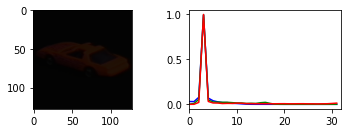

temps de recherche: 0.0861 secondes


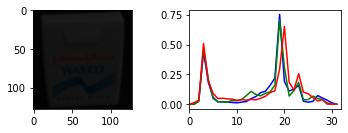

temps de recherche: 0.0605 secondes


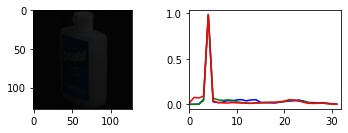

temps de recherche: 0.0485 secondes


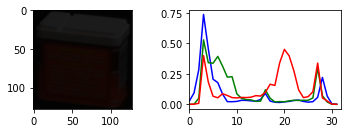

temps de recherche: 0.00988 secondes


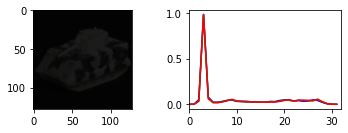

temps de recherche: 0.0182 secondes


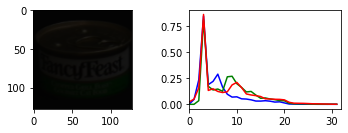

temps de recherche: 0.0725 secondes


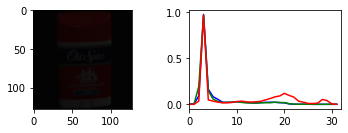

temps de recherche: 0.0661 secondes


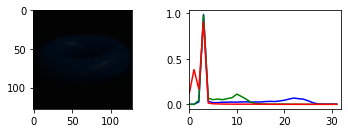

temps de recherche: 0.054 secondes


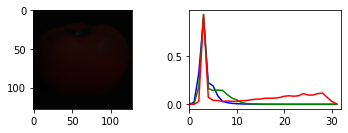

temps de recherche: 0.0276 secondes


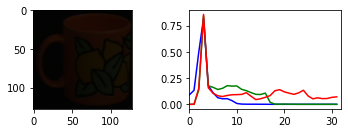

temps de recherche: 0.205 secondes


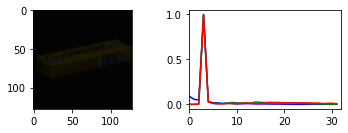

temps de recherche: 0.0547 secondes


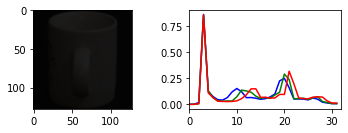

temps de recherche: 0.0597 secondes


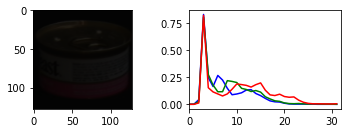

temps de recherche: 0.0559 secondes


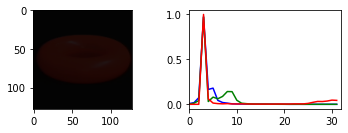

temps de recherche: 0.0273 secondes


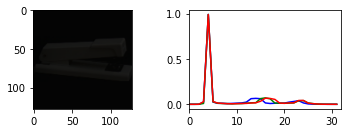

temps de recherche: 0.0477 secondes


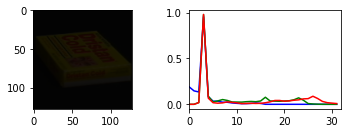

temps de recherche: 0.0495 secondes


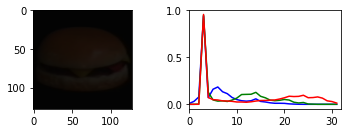

temps de recherche: 0.0247 secondes


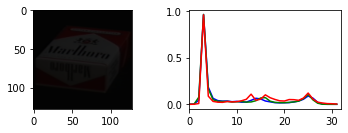

temps de recherche: 0.0581 secondes


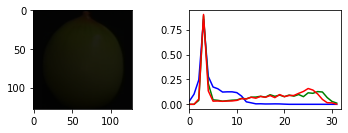

temps de recherche: 0.0333 secondes


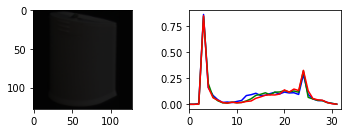

temps de recherche: 0.0191 secondes


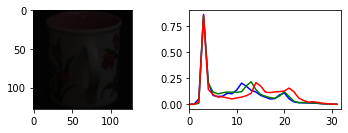

temps de recherche: 0.0545 secondes


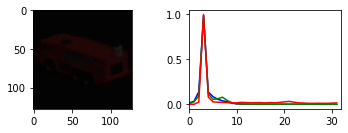

temps de recherche: 0.0513 secondes


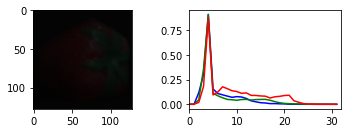

temps de recherche: 0.0498 secondes


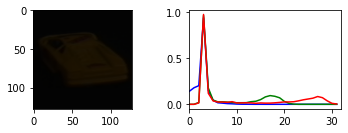

temps de recherche: 0.0503 secondes


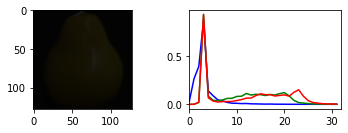

temps de recherche: 0.0623 secondes


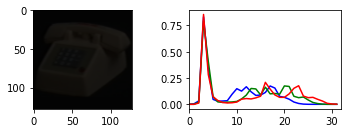

temps de recherche: 0.0494 secondes


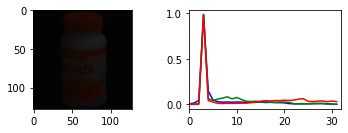

temps de recherche: 0.0588 secondes


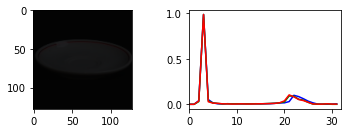

temps de recherche: 0.213 secondes


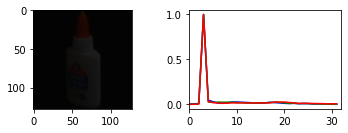

temps de recherche: 0.0484 secondes


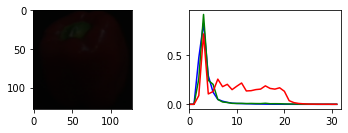

temps de recherche: 0.0281 secondes


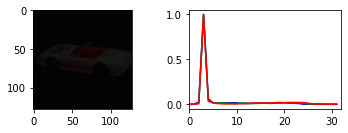

temps de recherche: 0.055 secondes


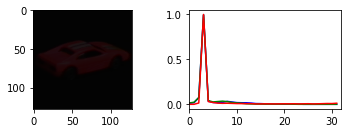

temps de recherche: 0.0539 secondes


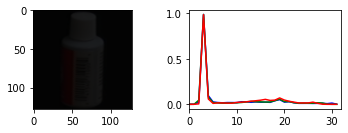

temps de recherche: 0.0555 secondes


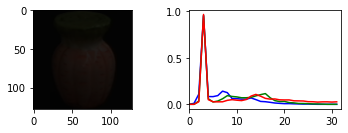

temps de recherche: 0.0522 secondes


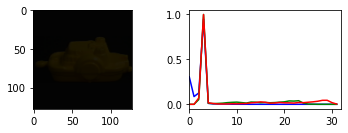

temps de recherche: 0.0519 secondes


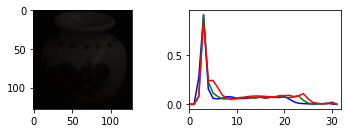

temps de recherche: 0.0258 secondes


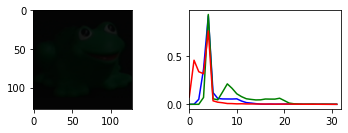

temps de recherche: 0.0184 secondes


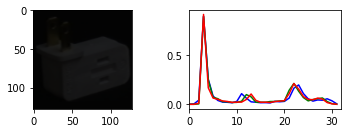

temps de recherche: 0.0483 secondes


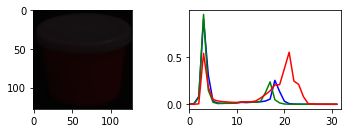

temps de recherche: 0.0539 secondes


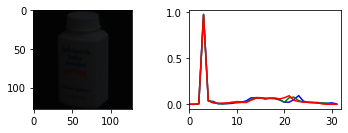

temps de recherche: 0.0502 secondes


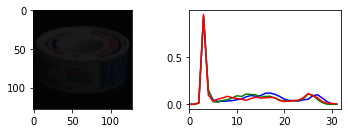

temps de recherche: 0.0454 secondes


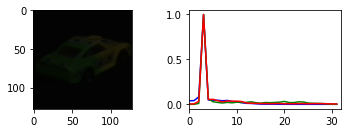

temps de recherche: 0.0504 secondes


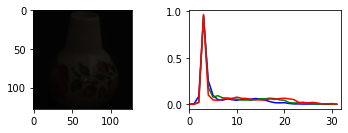

temps de recherche: 0.0552 secondes


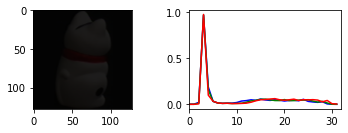

temps de recherche: 0.0525 secondes


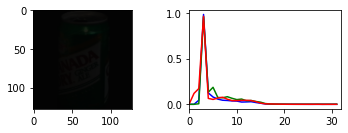

temps de recherche: 0.0641 secondes


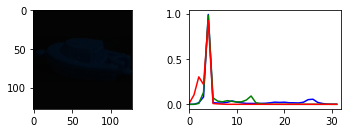

temps de recherche: 0.231 secondes


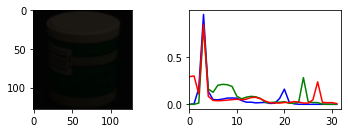

temps de recherche: 0.0557 secondes


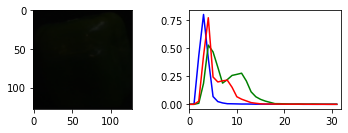

temps de recherche: 0.0266 secondes


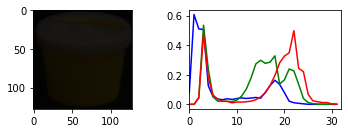

temps de recherche: 0.0249 secondes


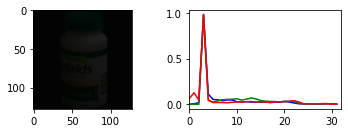

temps de recherche: 0.0671 secondes


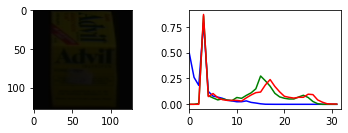

temps de recherche: 0.0592 secondes


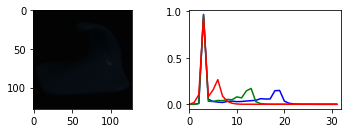

temps de recherche: 0.0243 secondes


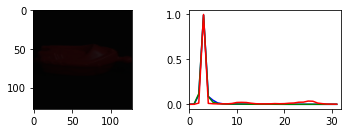

temps de recherche: 0.0522 secondes


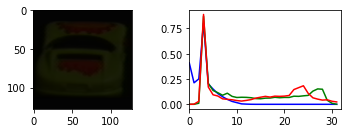

temps de recherche: 0.0418 secondes


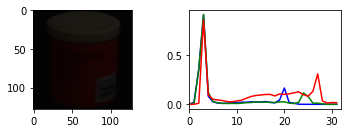

temps de recherche: 0.0559 secondes


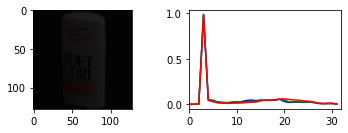

temps de recherche: 0.0528 secondes


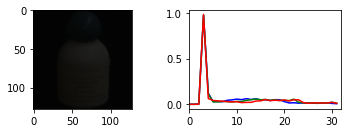

temps de recherche: 0.0545 secondes


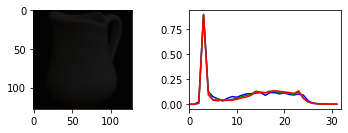

temps de recherche: 0.0584 secondes


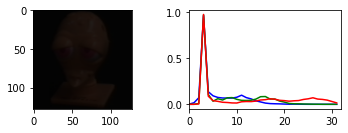

temps de recherche: 0.0598 secondes


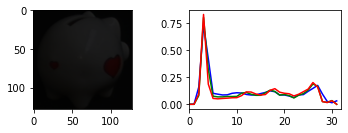

temps de recherche: 0.0276 secondes


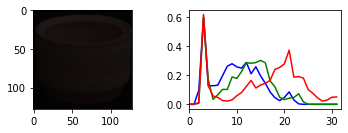

temps de recherche: 0.0507 secondes


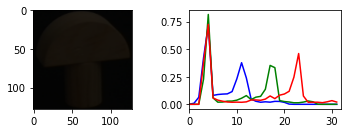

temps de recherche: 0.05 secondes


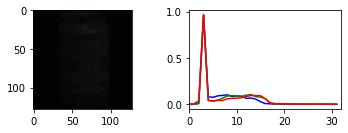

temps de recherche: 0.226 secondes


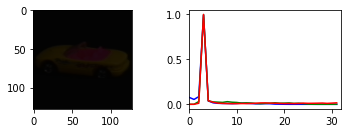

temps de recherche: 0.021 secondes


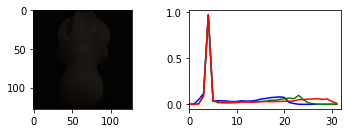

temps de recherche: 0.0484 secondes


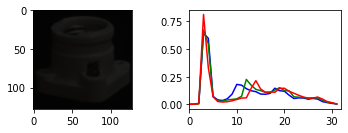

temps de recherche: 0.0226 secondes


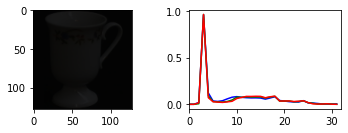

temps de recherche: 0.0571 secondes


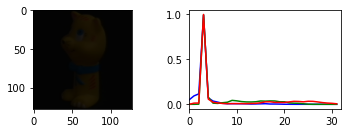

temps de recherche: 0.0541 secondes


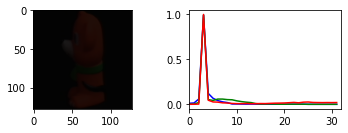

temps de recherche: 0.0573 secondes


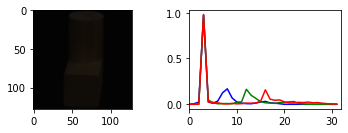

temps de recherche: 0.0528 secondes


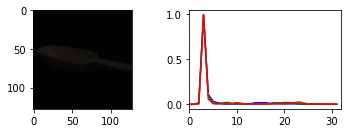

temps de recherche: 0.0546 secondes


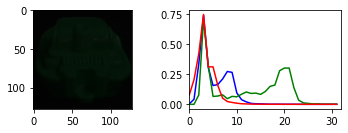

temps de recherche: 0.0243 secondes


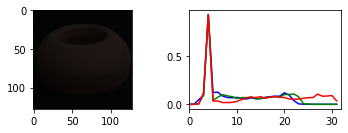

temps de recherche: 0.025 secondes


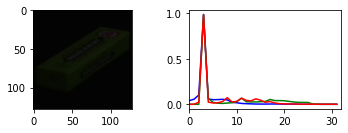

temps de recherche: 0.0383 secondes


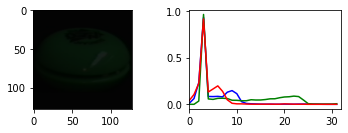

temps de recherche: 0.0526 secondes


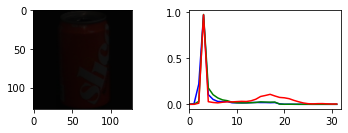

temps de recherche: 0.0546 secondes


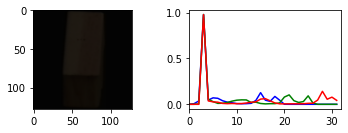

temps de recherche: 0.0582 secondes


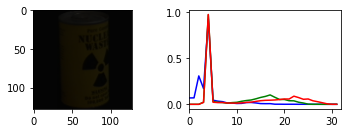

temps de recherche: 0.0448 secondes


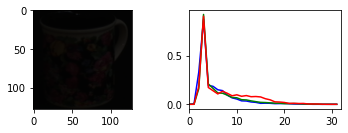

temps de recherche: 0.0629 secondes


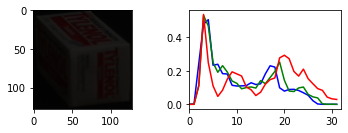

temps de recherche: 0.0567 secondes


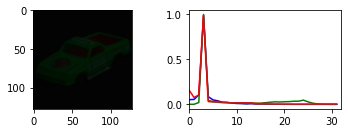

temps de recherche: 0.25 secondes


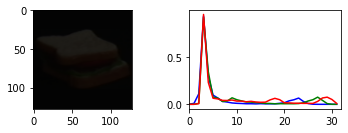

temps de recherche: 0.054 secondes


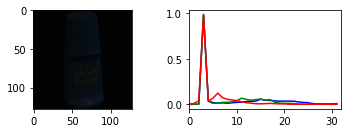

temps de recherche: 0.0529 secondes
temps d'évaluation: 58.96 secondes


In [119]:
lsh_conf_matrix = LSH.evaluate()

In [120]:
lsh_conf_matrix

array([[3., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 5., ..., 0., 0., 0.],
       ...,
       [1., 0., 0., ..., 3., 0., 0.],
       [0., 0., 0., ..., 0., 3., 0.],
       [0., 0., 0., ..., 0., 0., 6.]])

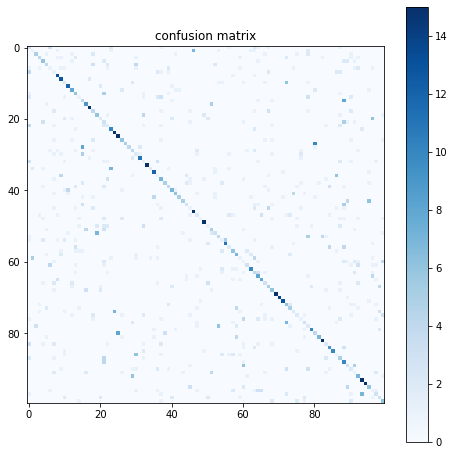

In [121]:
draw(cf=lsh_conf_matrix)

### Accuracy

In [122]:
get_accuracy(cf=lsh_conf_matrix)

Accuracy d'évaluation:  39.4%
Erreur d'évaluation: 60.6%


### Tests sur images externes

#### Test_ 1: image requete tasse. Nous obtenons 6 bons images de tasses resultats . les faux resultats sont uniquement proche de la forme ou la couleur de l'image requête.

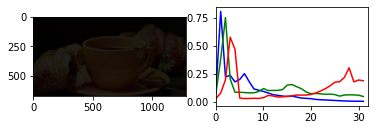

temps de recherche: 0.0663 secondes
> recherche  --input  ./samples/tasse3.jpg 

Images                     Distances
------                     ---------
obj15__255.png		 2.6116069816105623

obj44__90.png		 2.633325914082095

obj69__85.png		 2.644617996526431

obj59__230.png		 2.6533486880662425

obj59__235.png		 2.665707239423829

obj15__260.png		 2.719342685765919

obj55__340.png		 2.722277523920314

obj59__225.png		 2.7284115912621703

obj16__145.png		 2.7597048680606244

obj44__260.png		 2.7820841176505247

obj32__335.png		 2.799256250578201

obj59__240.png		 2.7992965858209575

obj59__310.png		 2.810262213300325

obj12__195.png		 2.812073018893511

obj55__345.png		 2.8356067735844674



In [123]:
# image requete tasse
path_image_query = "./samples/tasse3.jpg"

query = prepareQuery(path_image_query=path_image_query)

LSH.searchFromQuery(query)
res = LSH.afficheResultats(path_image_query)

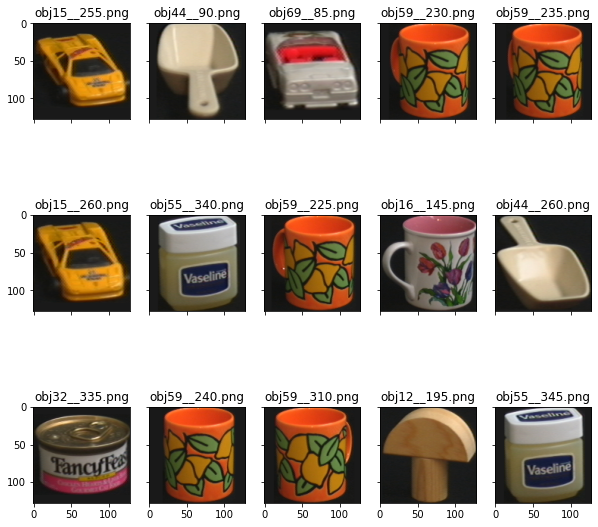

In [124]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

#### Test 2 : image tasse. Nous obtenons 5 images proches de la forme  (boites ronde) et 5 autres proche de la couleur (blanche). Mais une seule image de tasses.

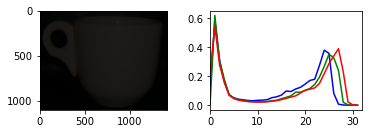

temps de recherche: 0.0605 secondes
> recherche  --input  ./samples/tasse.png 

Images                     Distances
------                     ---------
obj65__330.png		 3.154452955564108

obj65__335.png		 3.17874155731646

obj44__270.png		 3.281340244302899

obj67__275.png		 3.3371053111575835

obj71__115.png		 3.396267070782051

obj71__120.png		 3.4892599902930885

obj71__95.png		 3.496677492482835

obj65__340.png		 3.526203560165983

obj67__270.png		 3.528822129714771

obj71__125.png		 3.5288510009179945

obj45__80.png		 3.545256490268757

obj74__95.png		 3.5459699666789763

obj71__130.png		 3.5730641964386862

obj54__85.png		 3.587197820851889

obj4__60.png		 3.74442285927365



In [125]:
# image requete tasse
path_image_query = "./samples/tasse.png"

query = prepareQuery(path_image_query=path_image_query)

LSH.searchFromQuery(query)
res = LSH.afficheResultats(path_image_query)

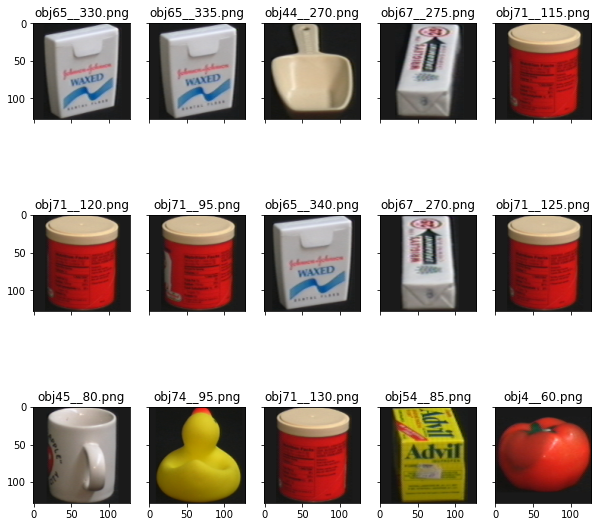

In [126]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

#### Test 3 : Hambourger.  Aucun bons résultats, juste certaines similaires à la couleur (jaune) et à la forme (cylindrique) 

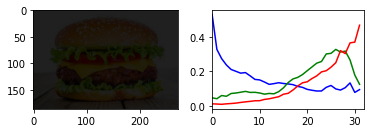

temps de recherche: 0.0223 secondes
> recherche  --input  ./samples/hambourger.jpeg 

Images                     Distances
------                     ---------
obj54__255.png		 3.4297797700284374

obj6__270.png		 3.66739125312383

obj74__160.png		 3.683630302884753

obj74__345.png		 3.7994239902762983

obj74__340.png		 3.8054434889135473

obj66__100.png		 3.8241199498295075

obj10__225.png		 3.948724852702673

obj74__155.png		 4.027313548881434

obj96__270.png		 4.034047604041505

obj74__350.png		 4.067598644842173

obj58__10.png		 4.089737569457289

obj87__65.png		 4.144881077263642

obj69__95.png		 4.175070549900675

obj74__15.png		 4.180686068754888

obj10__55.png		 4.191815313572752



In [127]:
# image requete tasse
path_image_query = "./samples/hambourger.jpeg"

query = prepareQuery(path_image_query=path_image_query)

LSH.searchFromQuery(query)
res = LSH.afficheResultats(path_image_query)

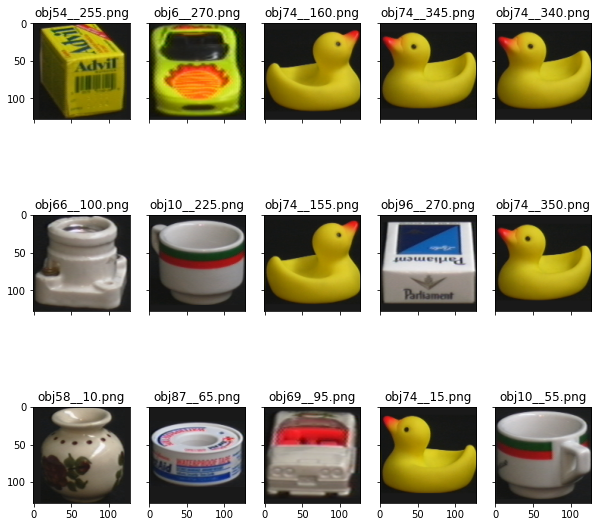

In [128]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

#### Test 4: automobile (camion).  7 images de résultats, similaires forme et/ou couleur, donc 2 images de camions très proches de l'image requête

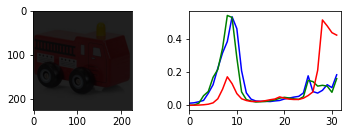

temps de recherche: 0.0587 secondes
> recherche  --input  ./samples/bus.jpeg 

Images                     Distances
------                     ---------
obj23__275.png		 3.1327693659942555

obj23__270.png		 3.7284858789224034

obj19__80.png		 3.9189974386083084

obj32__40.png		 3.9200704420791626

obj76__275.png		 3.9287212147473474

obj76__90.png		 3.972191818807566

obj32__35.png		 4.078804421931656

obj79__80.png		 4.085345504742591

obj55__330.png		 4.086711594377285

obj41__320.png		 4.114405624671904

obj23__280.png		 4.128598950931842

obj31__250.png		 4.144731539725357

obj48__35.png		 4.147508955853201

obj19__85.png		 4.252334543036499

obj41__315.png		 4.259537165102828



In [129]:
# image requete tasse
path_image_query = "./samples/bus.jpeg"

query = prepareQuery(path_image_query=path_image_query)

LSH.searchFromQuery(query)
res = LSH.afficheResultats(path_image_query)

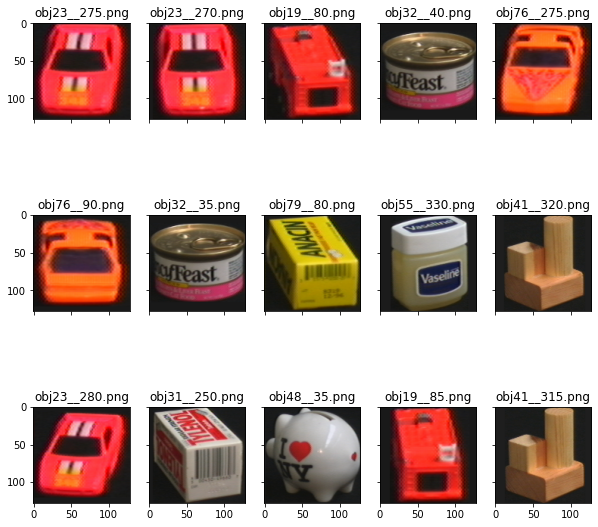

In [130]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

####  Test 5: canette coca. Aucun bons résultats, uniquement certains proche de la forme (cylindrique)

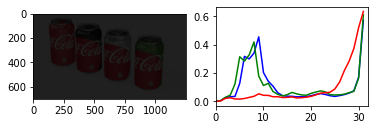

temps de recherche: 0.0553 secondes
> recherche  --input  ./samples/canettecoca.jpg 

Images                     Distances
------                     ---------
obj8__90.png		 3.182383943787927

obj32__210.png		 3.260666304427689

obj32__215.png		 3.2776609843317694

obj28__55.png		 3.395262325991808

obj59__140.png		 3.479093143784876

obj28__60.png		 3.5797252704467954

obj41__125.png		 3.634516760139592

obj82__5.png		 3.646513613053101

obj37__260.png		 3.6498444607705913

obj32__120.png		 3.6646418343321985

obj32__115.png		 3.674687944684458

obj82__0.png		 3.684921588226454

obj56__280.png		 3.7086888777516305

obj56__275.png		 3.7847970016547507

obj51__290.png		 3.7859638434058405



In [131]:
# image requete tasse
path_image_query = "./samples/canettecoca.jpg"

query = prepareQuery(path_image_query=path_image_query)

LSH.searchFromQuery(query)
res = LSH.afficheResultats(path_image_query)

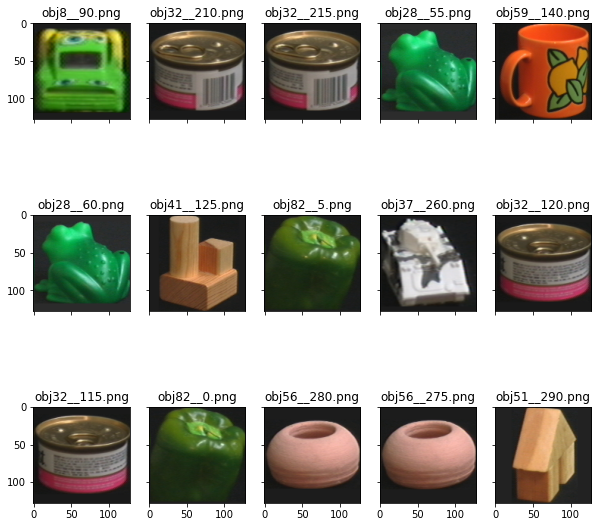

In [132]:
# Visualiser les résulatas
AfficherResultats(resultats = res)

## Conclusion: méthode LSH
### Cette méthode est également très rapide, elle nous donne de bonne resultats sur notre jeu de test, soit 39.4%. Et également quelques bons resultats sur les données externe, se trompe moins  sur la couleur que la forme.

# Conclusion 
## A fin de réduire considérablement le temps de calcul, nous avons procédé à une du de dimensions , en passant de 96 dimensions couleurs à 52 dimensions et de 7 dimensions formes à 2 dimensions, par application d'une décomposition en composants principales PCA, tout en assurant de conserver 99% d'informations.
## Pour la méthode KD-Tree, nous procédons par un choix aléotoire du noeud racine (axe), nous pensons que cela peut bien influencer le résultat. Cette méthode est très rapide pour la recherche, car explore toujours les voisins les plus proches, moyenne une distance euclidienne.
## La méthode kmeans beaucoup influencé par le nombre de clusters, cependant nous avons veillé à cette sélection utilisant la méthode du coude (Elbow method) et la classification hierarchique. Mais toutefois les résultats obtenus sont pas satisfaisants, et cette méthode moins rapide.
## La méthode de hachage LSH (Locaty sensitive Hashing), implementer à partir de la bibliothèque lshashpy3, c'est avéré aussi rapide comme KD-Tree, et la meilleur métrique de similarité rétenue est la distance euclidienne au lieu de hamming, car nous manipulons des tableau de flottants. Les résultats sont visibles, tant sur la performance sur le jeu d'évalution que sur des données externes.

## Au regard de notre jeu d'évaluation, nous pouvons conclure que la méthode LSH est la plus rapide, 58.96 secondes, soit 71.9 secondes pour kmeans, et  211.6 secondes pour KD-Tree.
## La méthode LSH, est la plus performante soit 39.4%, et en moyenne 3.4% pour KD-Tree, et 3.14 pour Kmeans et 